# **Diplomado IA: Audio y Video - Parte 1**. <br> Práctico 1: Introducción al Análisis de Audio
---
---

**Profesores:**
- Alain Raymond
- Gabriel Sepúlveda
- Álvaro Soto

**Ayudante:**
- Andrés Villa
---
---

# **Instrucciones Generales**

El siguiente práctico se debe realizar de forma individual. El formato de entregar es el **archivo .ipynb con todas las celdas ejecutadas**. Las secciones donde se planteen preguntas de forma explícita, deben ser respondida en celdas de texto, y no se aceptará solo el _output_ de una celda de código como respuesta.

**Nombre alumno:** FRANCISCO MENA

El siguiente práctico cuanta con 3 secciones donde cada una contendrá 1 o más actividades a realizar. Algunas actividades correspondrán a escribir código y otras a responder preguntas. 

Antes de responder, se recomienda **fuertemente** revisar las secciones previas donde se desarrollan los ejemplos, dado que algunas de las actividades pueden ser completadas reutilizando el mismo código.

**Fecha de entrega:** viernes 30 de abril de 2021, 23:59 hrs.

---
**IMPORTANTE:** habrá un bonus de 1 décima para todos aquellos alumnos/as que muestren buen orden en sus respuestas (esto aplica a legibilidad de código, buena redacción, formalidad, organización del jupyter notebook, seguimiento de instrucciones, etc). El criterio lo pondrá cada ayudante corrector. La nota máxima obtenible en el laboratorio es 7.0

#Preamble

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd

import pylab

%matplotlib inline
pylab.rcParams['figure.figsize']=9,6 # default: [6, 4]

#Análisis en frecuencia

## Fast Fourier Transform (FFT)

Comenzaremos por analizar una señal sinusoidal que posee una frecuencia de 5 [Hz], una duración de 1[s] y que ha sido muestreada a una tasa de 512 [Hz]. Para ello graficaremos su evolución temporal, así como también, sus componentes en frecuencia (espectro).

Text(0, 0.5, 'Amplitude')

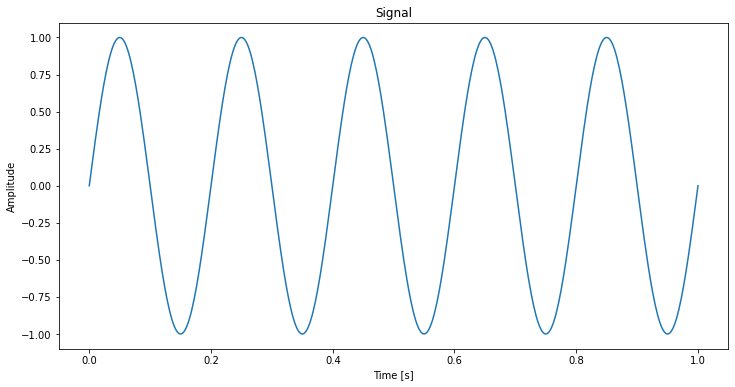

In [36]:
f = 5.0 # [Hz]
sampling_rate = 512
t = np.linspace( 0, 1, sampling_rate ) # [0, 1] [s]
y = np.sin( 2*np.pi*f*t )

ax = plt.axes()
ax.plot( t, y )
plt.title( 'Signal' )
plt.xlabel( 'Time [s]' )
plt.ylabel( 'Amplitude' )

Para poder obtener el espectro de la señal sinusoidal, aplicaremos la FFT mediante la función fft de la biblioteca numpy.

In [ ]:
spectrum = np.fft.fft( y )
print( 'y = sin(t) dim : %s' % (str(y.shape)) )
print( 'FFT(y) dim     : %s' % (str(spectrum.shape)) )

y = sin(t) dim : (512,)
FFT(y) dim     : (512,)


Debido a que el vector de salida de la FFT está compuesto por el espectro tanto de frecuencias positivas, y luego negativas, no podemos graficar este vector para frecuencias continuamente crecientes. Para obtener un vector de frecuencias que esté en concordancia con la salida de la FFT, utilizaremos la función fftfreq de numpy, tal como vemos a continuación.

In [ ]:
freq_bins = np.fft.fftfreq( spectrum.size, d = 1/float(sampling_rate) )

Text(0.5, 1.0, 'Power spectrum')

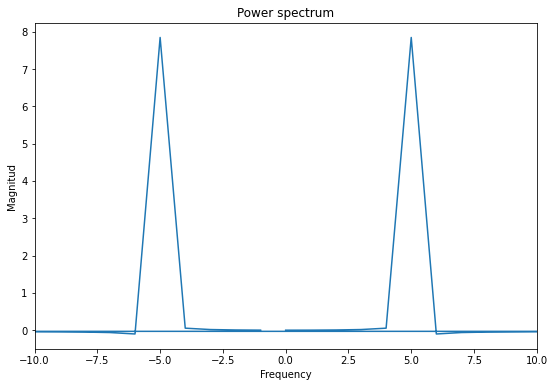

In [ ]:
plt.plot(freq_bins, spectrum.real)
plt.xlim( (-10, 10) )
plt.xlabel( 'Frequency' )
plt.ylabel( 'Magnitud' )
plt.title( 'Power spectrum' )

## Serie de Fourier

En esta sección, calcularemos la serie de Fourier trigonométrica para un grupo de señales periódicas, para las cuales hemos calculado sus coeficientes $a_{0}$, $a_{k}$ y $b_{k}$ según las ecuaciones que se ven a continuación:


$\hat{f}(t) = \frac{a_{0}}{2} + \sum_{n=1}^{\infty} \left[ a_{n} \cdot cos(\frac{2 \pi}{T} n t) + b_{n} \cdot sin(\frac{2 \pi}{T} n t) \right]$

$a_{0} = \frac{2}{T} \int_{-\frac{T}{2}}^{\frac{T}{2}} f(t) dt$

$a_{n} = \frac{2}{T} \int_{-\frac{T}{2}}^{\frac{T}{2}} f(t) cos(\frac{2 \pi}{T} n t) dt$

$b_{n} = \frac{2}{T} \int_{-\frac{T}{2}}^{\frac{T}{2}} f(t) sin(\frac{2 \pi}{T} n t) dt$

Comenzaremos por definir la función "generate_animation" que nos permitirá generar una animación con la evolución de la señal que estamos aproximando, en la medidad que vamos agregando componentes armónicos de mayor frecuencia (k cada vez mayor).

In [37]:
import time
from matplotlib import animation, rc

def generate_animation(x, y_history, freq_bins, history_freq):

  fig, (ax1, ax2) = plt.subplots( 2 )

  # Cerramos el gráfico creado porque luego se creará uno con otra función 
  # específica para animar
  plt.close()

  ax1.set_ylim( (-2.5, 2.5) )
  ax2.set_xlim( (-100, 100) )

  graph1, = ax1.plot( x, y_history[0] )
  graph2, = ax2.plot( freq_bins, history_freq[0] )

  def animate(i):
    graph1.set_data( x, y_history[i] )
    graph2.set_data( freq_bins, history_freq[i] )

  anim = animation.FuncAnimation( fig, animate, frames = len(y_history) )

  # Este código es para que funcione en google colab
  rc( 'animation', html = 'jshtml' )

  return anim

### Señal cuadrada

A continuación se presentan los coeficientes de la serie de Fourier trigonométrica para una señal cuadrada impar y centrada en cero.


$a_{0} = 0$

$a_{n} = 0$

$b_{n} = \frac{4}{n \cdot \pi} \cdot \left\{
  \begin{array}{ll}
    0 & if \; n \; even \\
    1 & if \; n \; odd
  \end{array}
\right.$

$f(t) = \frac{4}{\pi} \cdot \sum_{n=1, 3, 5,...}^{\infty} \frac{1}{n} \cdot sin( n \cdot 2 \cdot \pi \cdot f \cdot t)$

In [38]:
import copy

f = 5.0 # [Hz]
sampling_rate = 512
t = np.linspace( 0, 1, sampling_rate ) # [0, 1] [s]
y = np.zeros( t.shape )

history = list()
history_freq = list()

for i in range( 1, 200, 2 ):
  y += (4/np.pi) * (1/float(i)) * np.sin( i*2*np.pi*f*t )
  history.append( copy.copy( y ) )
  fft = np.fft.fft( y )
  spectrum = np.abs( fft )
  history_freq.append( copy.copy( spectrum.real ) )

freq_bins = np.fft.fftfreq( spectrum.size, d = 1/float(sampling_rate) )

generate_animation(t, history, freq_bins, history_freq)

### Señal triangular

A continuación se presentan los coeficientes de la serie de Fourier trigonométrica para una señal triagular impar y centrada en cero.


$a_{0} = 0$

$a_{n} = 0$

$b_{n} = \frac{8}{\pi^2 \cdot n^2} \cdot \left\{
  \begin{array}{lc}
    (-1)^{(n-1)/2} & if \; n \; odd \\ \\
    0 & if \; n \; even
  \end{array}
\right.$

$f(t) = \frac{8}{\pi^2} \cdot \sum_{n=1, 3, 5,...}^{\infty} \frac{(-1)^{(n-1)/2}}{n^2} \cdot sin ( n \cdot 2 \cdot \pi \cdot f \cdot t)$

In [39]:
import copy

f = 5.0 # [Hz]
sampling_rate = 512
t = np.linspace( 0, 1, sampling_rate ) # [0, 1] [s]
y = np.zeros( t.shape )

history = list()
history_freq = list()

for i in range( 1, 20, 2 ):
  y += (8/(np.pi**2)) * (((-1)**((i-1)/2))/float(i**2)) * np.sin( i*2*np.pi*f*t )
  history.append( copy.copy( y ) )
  fft = np.fft.fft( y )
  spectrum = np.abs( fft )
  history_freq.append( copy.copy( spectrum.real ) )

freq_bins = np.fft.fftfreq( spectrum.size, d = 1/float(sampling_rate) )

generate_animation(t, history, freq_bins, history_freq)

### Señal diente de sierra (sawthoot)

A continuación se presentan los coeficientes de la serie de Fourier trigonométrica para una señal diente de sierra impar y no centrada en cero.

$a_{0} = 1$

$a_{n} = 0$

$b_{n} = - \frac{1}{n \cdot \pi}$

$f(t) = \frac{1}{2} - \frac{1}{\pi} \cdot \sum_{n=1}^{\infty} \frac{1}{n} \cdot sin ( n \cdot 2 \cdot \pi \cdot f \cdot t)$

In [40]:
import copy

f = 5.0 # [Hz]
sampling_rate = 512
t = np.linspace( 0, 1, sampling_rate ) # [0, 1] [s]
y = np.zeros( t.shape )

history = list()
history_freq = list()

y += 1/2.0
for i in range( 1, 100 ):
  y += - (1/np.pi) * (1/float(i)) * np.sin( i*2*np.pi*f*t )
  history.append( copy.copy( y ) )
  fft = np.fft.fft( y )
  spectrum = np.abs( fft )
  history_freq.append( copy.copy( spectrum.real ) )

freq_bins = np.fft.fftfreq( spectrum.size, d = 1/float(sampling_rate) )

generate_animation(t, history, freq_bins, history_freq)

## Actividades

### Actividad 1.1

Responda la siguiente pregunta: ¿ Por que el vector de frecuencias generado por la función *fftfreq* de *numpy* posee en su primera mitad número positivos, y en la segunda mitad, números negativos ?

**Respuesta:** porque no hay más frecuencias disponibles para los valores sobre N/2, por lo que el espectro de energia se distribuye sobre las mismas frecuencias pero en el eje negativo

###Actividad 1.2

Calcule los coeficientes de la serir de Fourier trigonométrica para una señal cuadrada impar, de valor mínimo 0 y valor máximo 2 (no centrada en cero), tal como la que aparece abajo en la figura. Luego, programe una rutina para generar una animación en la cual se vea su formación en la medida que se van agregando componentes armónicos a la serie.

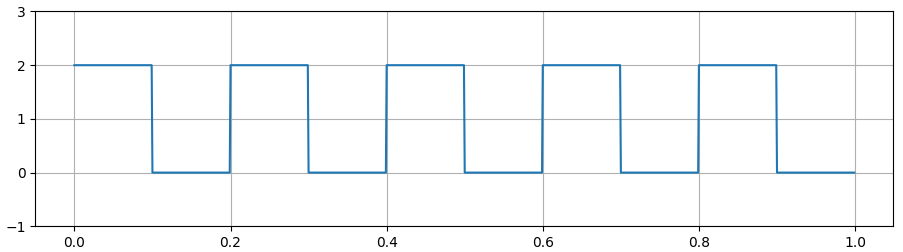

Como la única diferencia es que la señal esta trasladada por una unidad en el eje y, solo el coeficiente $a_{0}$ cambia:


$a_{0} = 1$

$a_{n} = 0$

$b_{n} = \frac{4}{n \cdot \pi} \cdot \left\{
  \begin{array}{ll}
    0 & if \; n \; even \\
    1 & if \; n \; odd
  \end{array}
\right.$


In [41]:

f = 5.0 # [Hz]
sampling_rate = 512
t = np.linspace( 0, 1, sampling_rate ) # [0, 1] [s]
y = np.zeros( t.shape )

history = list()
history_freq = list()

y += 1 #termino n=0
for i in range( 1, 200, 2 ):
  y += (4/np.pi) * (1/float(i)) * np.sin( i*2*np.pi*f*t )
  history.append( copy.copy( y ) )
  fft = np.fft.fft( y )
  spectrum = np.abs( fft )
  history_freq.append( copy.copy( spectrum.real ) )

freq_bins = np.fft.fftfreq( spectrum.size, d = 1/float(sampling_rate) )

generate_animation(t, history, freq_bins, history_freq)

###Actividad 1.3

Responda la siguiente pregunta: ¿ En qué se diferencia el **espectro** de la señal cuadrada entregada en el ejemplo (centrada de cero), de la solicitada en la actividad 1.2 ?

**Respuesta:** Ambos espectros son muy similares, la principal diferencia es que en este nuevo espectro hay un peak cerca del cero, mientras que en la señal cuadrada centrada en el origen no lo hay.

#Análisis tiempo-frecuencia

##Short-time fourier transform (STFT)

###STFT sobre un grupo de señales sinusoidales

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pylab

import librosa
import librosa.display

%matplotlib inline
pylab.rcParams['figure.figsize'] = 12,6 # default: [6, 4]

Text(0, 0.5, 'Amplitude')

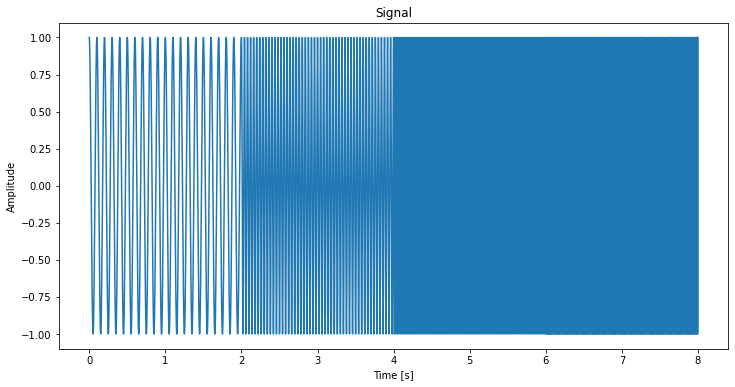

In [ ]:
sampling_rate = 8192
t = np.linspace( 0, 8, 8*sampling_rate ) # [0, 8] [s]
dt = int(len(t)/4)

y1 = np.cos( 2*np.pi*10*t[0*dt:1*dt] ) # 10 [Hz]
y2 = np.cos( 2*np.pi*25*t[1*dt:2*dt] ) # 25 [Hz]
y3 = np.cos( 2*np.pi*50*t[2*dt:3*dt] ) # 50 [Hz]
y4 = np.cos( 2*np.pi*100*t[3*dt:4*dt] ) # 100 [Hz]
y = np.concatenate( (y1, y2, y3, y4) )

ax = plt.axes()
scat = ax.plot( t, y )
plt.title( 'Signal' )
plt.xlabel( 'Time [s]' )
plt.ylabel( 'Amplitude' )

(1025, 513)


[Text(0.5, 1.0, 'STFT')]

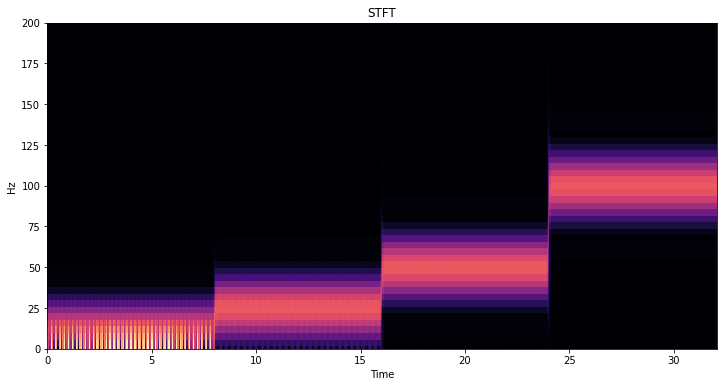

In [ ]:
spec = np.abs( librosa.stft( y, win_length = 512 ) )
print( spec.shape )

fig, ax = plt.subplots()
img = librosa.display.specshow( spec, x_axis = 'time', y_axis = 'linear', sr = sampling_rate, ax = ax ) # librosa default sr 22kHz
ax.set_ylim( [0, 200] )
ax.set( title = 'STFT' )

###STFT sobre un archivo de audio

In [12]:
!wget https://www2.cs.uic.edu/~i101/SoundFiles/Fanfare60.wav -q --show-progress
!wget https://file-examples-com.github.io/uploads/2017/11/file_example_MP3_700KB.mp3 -q --show-progressfile3 = "ChannelPlacement.wav"


Fanfare60.wav       100%[===================>]   2.52M  7.73MB/s    in 0.3s    
wget: unrecognized option '--show-progressfile3'
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


In [7]:
#from google.colab import files

#uploaded = files.upload()

#for fn in uploaded.keys():
 # print('User uploaded file "{name}" with length {length} bytes'.format(
  #    name=fn, length=len(uploaded[fn])))

In [13]:
file1 = "Fanfare60.wav"
audio_data, sampling_rate = librosa.load(file1, sr=None, mono=False)
#audio_data, sampling_rate = librosa.load( '14113-4-0-1.wav' )
print('Audio file sampling rate: %d [Hz]' % (sampling_rate))

Audio file sampling rate: 22050 [Hz]


In [14]:
ipd.Audio( audio_data, rate = sampling_rate )

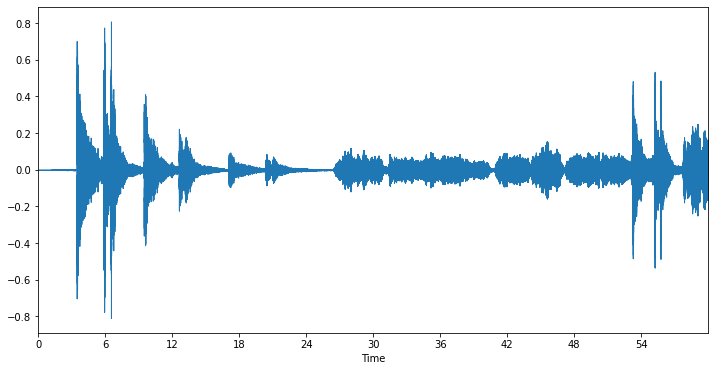

In [15]:
librosa.display.waveplot( audio_data, sr = sampling_rate )

In [16]:
spec = librosa.stft( audio_data )
spec_db = librosa.amplitude_to_db( np.abs( spec ), ref = np.max ) # 20*log( x / ref )

In [17]:
spec.shape

(1025, 2584)

[Text(0.5, 1.0, 'Audio signal STFT')]

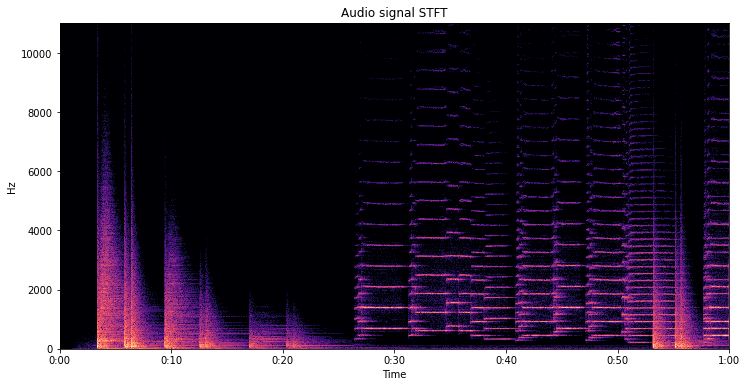

In [18]:
fig, ax = plt.subplots()
img = librosa.display.specshow( spec_db, x_axis='time', y_axis='linear', sr = sampling_rate, ax=ax )
ax.set( title = 'Audio signal STFT' )

##Mel Scale based transformations

###Mel Spectrogram

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pylab

import librosa
import librosa.display

%matplotlib inline
pylab.rcParams['figure.figsize'] = 12,6 # default: [6, 4]

Text(0, 0.5, 'Amplitude')

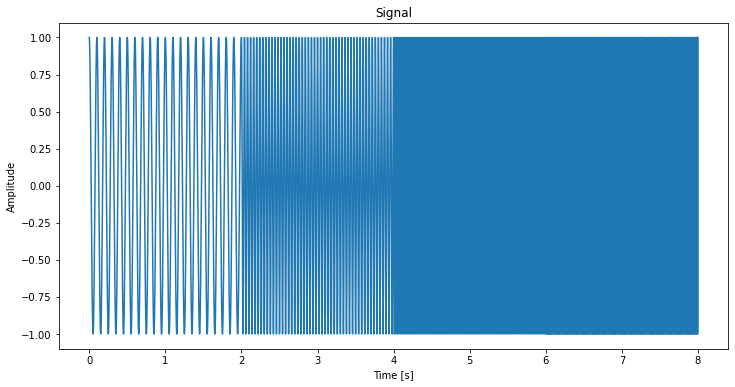

In [ ]:
sampling_rate = 8192
t = np.linspace( 0, 8, 8*sampling_rate ) # [0, 8] [s]
dt = int(len(t)/4)

y1 = np.cos( 2*np.pi*10*t[0*dt:1*dt] ) # 10 [Hz]
y2 = np.cos( 2*np.pi*25*t[1*dt:2*dt] ) # 25 [Hz]
y3 = np.cos( 2*np.pi*50*t[2*dt:3*dt] ) # 50 [Hz]
y4 = np.cos( 2*np.pi*100*t[3*dt:4*dt] ) # 100 [Hz]
y = np.concatenate( (y1, y2, y3, y4) )

ax = plt.axes()
scat = ax.plot( t, y )
plt.title( 'Signal' )
plt.xlabel( 'Time [s]' )
plt.ylabel( 'Amplitude' )

(256, 129)


/usr/local/lib/python3.7/dist-packages/librosa/filters.py:239: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  "Empty filters detected in mel frequency basis. "


[Text(0.5, 1.0, 'Mel-frequency spectrogram')]

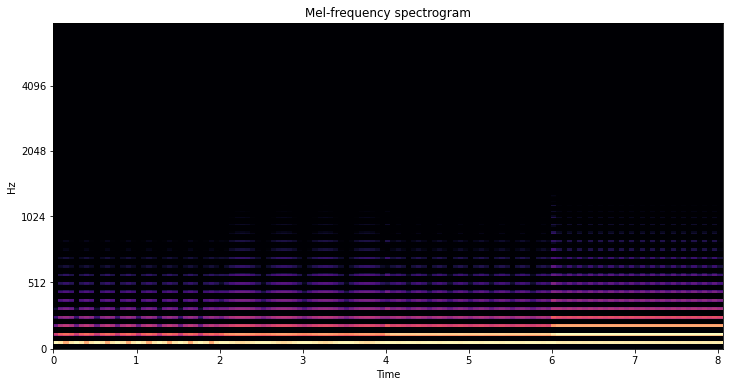

In [ ]:
S = librosa.feature.melspectrogram( y = y, sr = sampling_rate, n_mels = 256, n_fft = 128, fmax = 8000 )
S_dB = librosa.power_to_db( S, ref = np.max ) # 10*log( x / ref )
print(S.shape)
fig, ax = plt.subplots()
img = librosa.display.specshow(S_dB, x_axis = 'time', y_axis = 'mel', sr=sampling_rate, fmax=8000, ax=ax)
ax.set(title='Mel-frequency spectrogram')

###Mel-frequency Cepstral Coefficients (MFCC)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pylab

import librosa
import librosa.display

%matplotlib inline
pylab.rcParams['figure.figsize'] = 12,6 # default: [6, 4]

Text(0, 0.5, 'Amplitude')

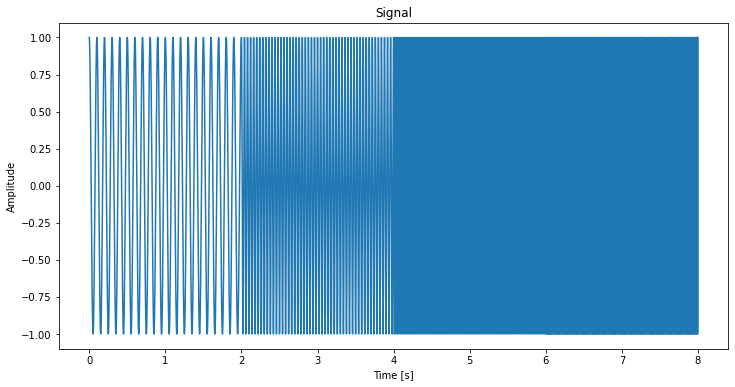

In [ ]:
sampling_rate = 8192
t = np.linspace( 0, 8, 8*sampling_rate ) # [0, 8] [s]
dt = int(len(t)/4)

y1 = np.cos( 2*np.pi*10*t[0*dt:1*dt] ) # 10 [Hz]
y2 = np.cos( 2*np.pi*25*t[1*dt:2*dt] ) # 25 [Hz]
y3 = np.cos( 2*np.pi*50*t[2*dt:3*dt] ) # 50 [Hz]
y4 = np.cos( 2*np.pi*100*t[3*dt:4*dt] ) # 100 [Hz]
y = np.concatenate( (y1, y2, y3, y4) )

ax = plt.axes()
scat = ax.plot( t, y )
plt.title( 'Signal' )
plt.xlabel( 'Time [s]' )
plt.ylabel( 'Amplitude' )

(40, 129)


[Text(0.5, 1.0, 'MFCC')]

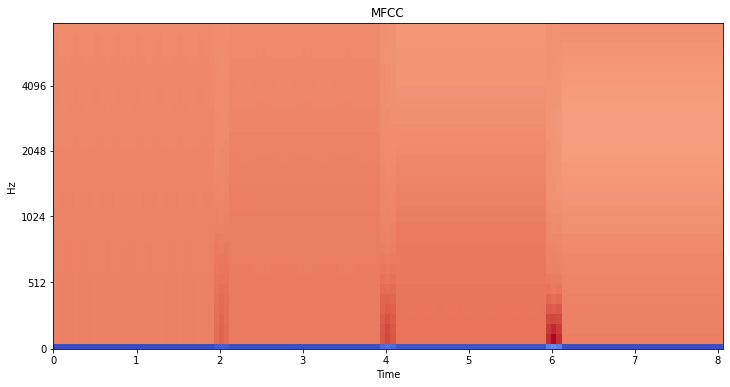

In [ ]:
mfccs = librosa.feature.mfcc( y = y, sr = sampling_rate, n_mfcc = 40 )
print(mfccs.shape)

fig, ax = plt.subplots()
img = librosa.display.specshow( mfccs, x_axis = 'time', y_axis = 'mel', sr = sampling_rate, fmax = 8000, ax = ax )
ax.set(title='MFCC')

###MFCC sobre un archivo de audio

In [ ]:
#from google.colab import files

#uploaded = files.upload()

#for fn in uploaded.keys():
 # print('User uploaded file "{name}" with length {length} bytes'.format(
  #    name=fn, length=len(uploaded[fn])))

In [ ]:
audio_data, sampling_rate = librosa.load( '7061-6-0-0.wav' )
print('Audio file sampling rate: %d [Hz]' % (sampling_rate))

In [19]:
ipd.Audio( audio_data, rate = sampling_rate )

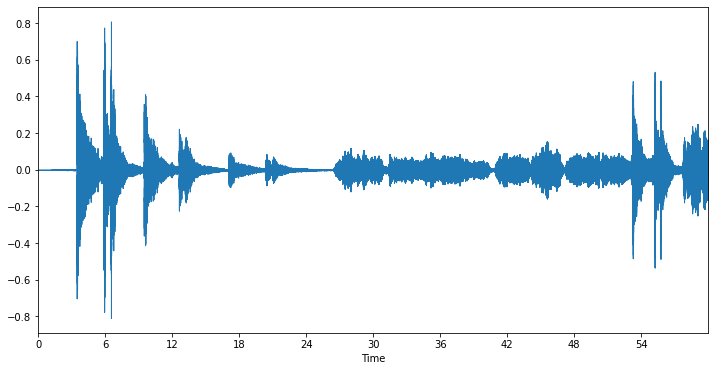

In [20]:
librosa.display.waveplot( audio_data, sr = sampling_rate )

(40, 2584)


[Text(0.5, 1.0, 'MFCC')]

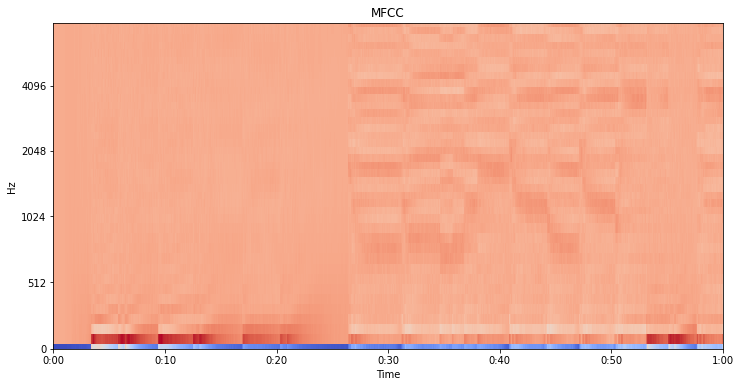

In [22]:
mfccs = librosa.feature.mfcc( y = audio_data, sr = sampling_rate, n_mfcc = 40 )
print( mfccs.shape )

fig, ax = plt.subplots()
img = librosa.display.specshow( mfccs, x_axis = 'time', y_axis = 'mel', sr = sampling_rate, fmax = 8000, ax = ax )
ax.set(title='MFCC')

##Actividades

###Actividad 2.1

Responda la siguiente pregunta: Cuando utilizamos transformaciones basadas en ventanas temporales como en el caso de STFT, ¿ cuál es el efecto sobre la precisión de la frecuencia cuando aumentamos el tamaño de la ventana ?

**Respuesta:** al aumentar la ventana temporal, se pierde resolución en tiempo, pero aumenta la precisión en frecuencia.

#Clasificación de sonidos

En esta sección utilizaremos el dataset UrbanSound8K (1) para entrenar una red neuronal densa para la tarea de clasificación de sonidos.

Este dataset contiene 10 classes que son especificadas a continuación:

 * air_conditioner
 * car_horn
 * children_playing
 * dog_bark
 * drilling
 * enginge_idling
 * gun_shot
 * jackhammer
 * siren
 * street_music


(1) J. Salamon, C. Jacoby and J. P. Bello, "A Dataset and Taxonomy for Urban Sound Research", 22nd ACM International Conference on Multimedia, Orlando USA, Nov. 2014.





In [26]:
!if [ ! -f UrbanSound8KSplit.tar.gz ]; then wget -q --show-progress https://www.dropbox.com/s/l1nq8ylb1ovepja/UrbanSound8KSplit.tar.gz; fi
!tar xzf UrbanSound8KSplit.tar.gz

UrbanSound8KSplit.t 100%[===================>]   5.61G  40.7MB/s    in 2m 0s   


In [27]:
import sys
import os.path
import csv
import librosa
import numpy as np
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

# Generador de datos de entrenamiento
class UrbanSoundDataset( Dataset ):

  def __init__( self, root_dir, transform = None ):
    self.sid2class = dict()
    self.dataset = list()
    self.labels = list()
    with open( os.path.join( root_dir, 'metadata/UrbanSound8K.csv' ) ) as fd:
      urban_sound_metadata = csv.reader( fd )
      for i, row in enumerate( urban_sound_metadata ):
        if i == 0: # skip header (first line)
          continue
        if row[6] not in self.sid2class:
          self.sid2class[row[6]] = row[7]
        filename = os.path.join( root_dir, 'audio', 'fold' + row[5], row[0] )
        audio, sample_rate = librosa.load( filename, res_type = 'kaiser_fast' )
        mfccs = librosa.feature.mfcc( y = audio, sr = sample_rate, n_mfcc = 40 )
        mfccs_avg = np.mean( mfccs.T, axis = 0 )
        self.dataset.append( mfccs_avg )
        self.labels.append( int(row[6]) )
    self.transform = transform

  def __len__( self ):
    return len( self.dataset )

  def __getitem__( self, idx ):
    if torch.is_tensor( idx ):
      idx = idx.tolist()
    sample = {'input': self.dataset[idx], 'target': self.labels[idx]}
    if self.transform:
      sample = self.transform( sample )
    return sample

# Conversor de datos generados por dataset
class ToTensor( object ):

  def __call__( self, sample ):
    input_, target_ = sample['input'].astype( np.float32 ), sample['target']
    return {'input': torch.from_numpy( input_ ),
            'target': target_ }

In [28]:
import torch
import torch.nn as nn

class UrbanSoundModel( nn.Module ):

  def __init__( self ):
    super( UrbanSoundModel, self ).__init__()
    self.layer1 = nn.Linear( 40, 256 )  # Capa 1: 40 entradas y 256 salidas
    self.layer2 = nn.Linear( 256, 256 ) # Capa 2: 256 entradas y 256 salida
    self.layer3 = nn.Linear( 256, 10 )  # Capa 2: 256 entradas y 10 salida
    self.activation_function_l1 = torch.nn.ReLU()
    self.activation_function_l2 = torch.nn.ReLU()
    self.activation_function_l3 = torch.nn.Softmax( dim = -1 )
    self.dropout_l1 = nn.Dropout( p = 0.5 )
    self.dropout_l2 = nn.Dropout( p = 0.5 )

  def forward( self, x ):
    x = self.dropout_l1( self.activation_function_l1( self.layer1( x ) ) )
    x = self.dropout_l2( self.activation_function_l2( self.layer2( x ) ) )
    x = self.activation_function_l3( self.layer3( x ) )
    return x

In [23]:
def model_accuracy( predicted, target ):
  predicted = predicted.reshape( -1, predicted.shape[-1] )
  predicted = predicted.argmax( 1 )
  target = target.reshape( -1 )
  correct = (predicted == target).sum()
  return float( correct ) / float( target.shape[0] )

def evaluation( model, criterion, dloader ):
  model.eval()
  epoch_eval_loss = 0
  epoch_eval_accu = 0
  for i_batch, sample_batched in enumerate( dloader ):
    input_batch = sample_batched['input'].to( device )
    target_batch = sample_batched['target'].to( device )

    prediction = model( input_batch ) # (batch_size, 1)

    eval_loss = criterion( prediction, target_batch )

    accuracy = model_accuracy( prediction.cpu().detach().numpy(), target_batch.cpu().detach().numpy() )

    epoch_eval_loss += eval_loss.item()
    epoch_eval_accu += accuracy

  epoch_eval_loss /= (i_batch+1)
  epoch_eval_accu /= (i_batch+1)
  return epoch_eval_loss, epoch_eval_accu

def fit( model, criterion, optimizer, n_epochs = 10 ):
  for epoch in range( n_epochs ):
    model.train()
    batch_per_epoch_train = len( us_trainset )
    for i_batch, sample_batched in enumerate( dataloader_train ):
      input_batch = sample_batched['input'].to( device )
      target_batch = sample_batched['target'].to( device )

      prediction = model( input_batch ) # (batch_size, 1)

      train_loss = criterion( prediction, target_batch )

      accuracy = model_accuracy( prediction.cpu().detach().numpy(), target_batch.cpu().detach().numpy() )

      optimizer.zero_grad()
      train_loss.backward()
      optimizer.step()

    epoch_train_loss, epoch_train_accu = evaluation( model, criterion, dataloader_train )
    print( 'Epoch %d: train loss %f acc %f' % (epoch+1, epoch_train_loss, epoch_train_accu ) )

    epoch_val_loss, epoch_val_accu = evaluation( model, criterion, dataloader_val )
    print( 'Epoch %d: val loss %f acc %f' % (epoch+1, epoch_val_loss, epoch_val_accu ) )

In [ ]:
# Creación de Dataloader
us_trainset = UrbanSoundDataset( 'UrbanSound8KSplit/train', transform = transforms.Compose( [ToTensor()] ) )
dataloader_train = DataLoader( us_trainset, batch_size = 32, shuffle = True, num_workers = 2 )

us_valset = UrbanSoundDataset( 'UrbanSound8KSplit/test', transform = transforms.Compose( [ToTensor()] ) )
dataloader_val = DataLoader( us_trainset, batch_size = 32, shuffle = True, num_workers = 2 )

/usr/local/lib/python3.7/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1103
  n_fft, y.shape[-1]
/usr/local/lib/python3.7/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1523
  n_fft, y.shape[-1]
/usr/local/lib/python3.7/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1323
  n_fft, y.shape[-1]


In [ ]:
import torch.optim as optim

device = torch.device( 'cuda' if torch.cuda.is_available() else 'cpu' )

# Creación de modelo
model = UrbanSoundModel()
model.to( device )

# Creación de instancias para la función de pérdida y optimizador
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam( model.parameters(), lr = 1e-4 )

# Entrenamiento del modelo
fit( model, criterion, optimizer, n_epochs = 800 )

Epoch 1: train loss 2.212509 acc 0.242437
Epoch 1: val loss 2.212546 acc 0.242437
Epoch 2: train loss 2.214358 acc 0.239837
Epoch 2: val loss 2.215096 acc 0.239108
Epoch 3: train loss 2.205117 acc 0.244372
Epoch 3: val loss 2.204906 acc 0.244372
Epoch 4: train loss 2.175783 acc 0.277191
Epoch 4: val loss 2.175224 acc 0.277920
Epoch 5: train loss 2.161544 acc 0.296772
Epoch 5: val loss 2.162512 acc 0.295678
Epoch 6: train loss 2.156165 acc 0.299261
Epoch 6: val loss 2.157149 acc 0.298167
Epoch 7: train loss 2.144285 acc 0.311247
Epoch 7: val loss 2.144311 acc 0.311247
Epoch 8: train loss 2.126150 acc 0.329512
Epoch 8: val loss 2.126280 acc 0.329512
Epoch 9: train loss 2.120886 acc 0.335854
Epoch 9: val loss 2.120306 acc 0.336584
Epoch 10: train loss 2.109119 acc 0.347508
Epoch 10: val loss 2.109710 acc 0.346778
Epoch 11: train loss 2.095591 acc 0.361840
Epoch 11: val loss 2.095975 acc 0.361476
Epoch 12: train loss 2.096994 acc 0.358685
Epoch 12: val loss 2.097473 acc 0.358321
Epoch 13: 

##Actividades

###Actividad 3.1

Repita el proceso de entrenamiento anterior utilizando los mismos datos y modelo de red neuronal *fully connected*, pero esta vez, calculando features mediante STFT.

In [29]:
import sys
import os.path
import csv
import librosa
import numpy as np
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

# Generador de datos de entrenamiento
class UrbanSoundDataset_stft( Dataset ):

  def __init__( self, root_dir, transform = None ):
    self.sid2class = dict()
    self.dataset = list()
    self.labels = list()
    with open( os.path.join( root_dir, 'metadata/UrbanSound8K.csv' ) ) as fd:
      urban_sound_metadata = csv.reader( fd )
      for i, row in enumerate( urban_sound_metadata ):
        if i == 0: # skip header (first line)
          continue
        if row[6] not in self.sid2class:
          self.sid2class[row[6]] = row[7]
        filename = os.path.join( root_dir, 'audio', 'fold' + row[5], row[0] )
        audio, sample_rate = librosa.load( filename, res_type = 'kaiser_fast' )
        #mfccs = librosa.feature.mfcc( y = audio, sr = sample_rate, n_mfcc = 40 )
        #mfccs_avg = np.mean( mfccs.T, axis = 0 )
        #self.dataset.append( mfccs_avg )
        stft_audio = librosa.stft( audio )
        stft_avg = np.mean( stft_audio.T, axis = 0 )
        self.dataset.append( stft_avg )
        self.labels.append( int(row[6]) )
    self.transform = transform

  def __len__( self ):
    return len( self.dataset )

  def __getitem__( self, idx ):
    if torch.is_tensor( idx ):
      idx = idx.tolist()
    sample = {'input': self.dataset[idx], 'target': self.labels[idx]}
    if self.transform:
      sample = self.transform( sample )
    return sample

# Conversor de datos generados por dataset
class ToTensor( object ):

  def __call__( self, sample ):
    input_, target_ = sample['input'].astype( np.float32 ), sample['target']
    return {'input': torch.from_numpy( input_ ),
            'target': target_ }

In [30]:
# Creación de Dataloader
us_trainset = UrbanSoundDataset_stft( 'UrbanSound8KSplit/train', transform = transforms.Compose( [ToTensor()] ) )
dataloader_train = DataLoader( us_trainset, batch_size = 32, shuffle = True, num_workers = 2 )

us_valset = UrbanSoundDataset_stft( 'UrbanSound8KSplit/test', transform = transforms.Compose( [ToTensor()] ) )
dataloader_val = DataLoader( us_trainset, batch_size = 32, shuffle = True, num_workers = 2 )

/usr/local/lib/python3.7/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1103
  n_fft, y.shape[-1]
/usr/local/lib/python3.7/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1523
  n_fft, y.shape[-1]
/usr/local/lib/python3.7/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1323
  n_fft, y.shape[-1]


In [34]:
import torch
import torch.nn as nn

class UrbanSoundModel_stft( nn.Module ):

  def __init__( self ):
    super( UrbanSoundModel_stft, self ).__init__()
    self.layer1 = nn.Linear( 1025, 256 )  # Capa 1: 40 entradas y 256 salidas
    self.layer2 = nn.Linear( 256, 256 ) # Capa 2: 256 entradas y 256 salida
    self.layer3 = nn.Linear( 256, 10 )  # Capa 2: 256 entradas y 10 salida
    self.activation_function_l1 = torch.nn.ReLU()
    self.activation_function_l2 = torch.nn.ReLU()
    self.activation_function_l3 = torch.nn.Softmax( dim = -1 )
    self.dropout_l1 = nn.Dropout( p = 0.5 )
    self.dropout_l2 = nn.Dropout( p = 0.5 )

  def forward( self, x ):
    x = self.dropout_l1( self.activation_function_l1( self.layer1( x ) ) )
    x = self.dropout_l2( self.activation_function_l2( self.layer2( x ) ) )
    x = self.activation_function_l3( self.layer3( x ) )
    return x

In [35]:
import torch.optim as optim

device = torch.device( 'cuda' if torch.cuda.is_available() else 'cpu' )

# Creación de modelo
model = UrbanSoundModel_stft()
model.to( device )

# Creación de instancias para la función de pérdida y optimizador
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam( model.parameters(), lr = 1e-4 )

# Entrenamiento del modelo
fit( model, criterion, optimizer, n_epochs = 800 )

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 1: train loss 2.299844 acc 0.146198


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 1: val loss 2.299832 acc 0.146198


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 2: train loss 2.296229 acc 0.124017


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 2: val loss 2.296222 acc 0.124017


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 3: train loss 2.290727 acc 0.114948


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 3: val loss 2.290733 acc 0.115313


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 4: train loss 2.284775 acc 0.117802


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 4: val loss 2.284638 acc 0.118167


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 5: train loss 2.278115 acc 0.132642


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 5: val loss 2.278240 acc 0.132277


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 6: train loss 2.270016 acc 0.172612


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 6: val loss 2.270203 acc 0.171883


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 7: train loss 2.262386 acc 0.182870


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 7: val loss 2.262055 acc 0.182870


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 8: train loss 2.253296 acc 0.198567


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 8: val loss 2.253039 acc 0.198931


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 9: train loss 2.243216 acc 0.228406


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 9: val loss 2.243251 acc 0.229135


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 10: train loss 2.232933 acc 0.261859


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 10: val loss 2.233412 acc 0.261130


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 11: train loss 2.221224 acc 0.289717


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 11: val loss 2.221647 acc 0.288258


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 12: train loss 2.210170 acc 0.298960


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 12: val loss 2.210063 acc 0.298960


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 13: train loss 2.198482 acc 0.308092


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 13: val loss 2.198474 acc 0.308092


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 14: train loss 2.188142 acc 0.312659


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 14: val loss 2.187409 acc 0.313388


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 15: train loss 2.177838 acc 0.320221


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 15: val loss 2.178240 acc 0.319492


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 16: train loss 2.168320 acc 0.326230


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 16: val loss 2.167489 acc 0.326960


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 17: train loss 2.159625 acc 0.331288


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 17: val loss 2.159989 acc 0.330923


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 18: train loss 2.151643 acc 0.339628


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 18: val loss 2.151854 acc 0.339992


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 19: train loss 2.143836 acc 0.344352


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 19: val loss 2.144249 acc 0.343988


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 20: train loss 2.136907 acc 0.351123


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 20: val loss 2.137285 acc 0.350393


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 21: train loss 2.130281 acc 0.357480


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 21: val loss 2.130551 acc 0.357116


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 22: train loss 2.124635 acc 0.359272


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 22: val loss 2.124908 acc 0.358178


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 23: train loss 2.118582 acc 0.367406


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 23: val loss 2.119227 acc 0.365947


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 24: train loss 2.113541 acc 0.369879


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 24: val loss 2.113279 acc 0.370608


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 25: train loss 2.107738 acc 0.372527


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 25: val loss 2.108505 acc 0.371797


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 26: train loss 2.103681 acc 0.376522


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 26: val loss 2.103713 acc 0.376157


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 27: train loss 2.098549 acc 0.381881


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 27: val loss 2.098813 acc 0.381881


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 28: train loss 2.094934 acc 0.382864


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 28: val loss 2.094697 acc 0.382864


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 29: train loss 2.091142 acc 0.388286


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 29: val loss 2.091049 acc 0.388286


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 30: train loss 2.086872 acc 0.394486


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 30: val loss 2.086443 acc 0.394850


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 31: train loss 2.083026 acc 0.395849


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 31: val loss 2.082402 acc 0.396214


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 32: train loss 2.078610 acc 0.399718


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 32: val loss 2.078358 acc 0.400082


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 33: train loss 2.074957 acc 0.402714


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 33: val loss 2.075856 acc 0.401256


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 34: train loss 2.071944 acc 0.403983


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 34: val loss 2.071051 acc 0.405441


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 35: train loss 2.068105 acc 0.410214


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 35: val loss 2.068848 acc 0.409484


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 36: train loss 2.066116 acc 0.411974


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 36: val loss 2.065431 acc 0.412703


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 37: train loss 2.063012 acc 0.413401


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 37: val loss 2.062328 acc 0.414130


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 38: train loss 2.059851 acc 0.417412


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 38: val loss 2.060350 acc 0.416683


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 39: train loss 2.056832 acc 0.420186


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 39: val loss 2.056823 acc 0.420186


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 40: train loss 2.053947 acc 0.421835


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 40: val loss 2.053742 acc 0.422200


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 41: train loss 2.051137 acc 0.422549


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 41: val loss 2.050954 acc 0.422913


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 42: train loss 2.047725 acc 0.426497


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 42: val loss 2.049302 acc 0.425038


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 43: train loss 2.046916 acc 0.427178


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 43: val loss 2.045991 acc 0.427908


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 44: train loss 2.043844 acc 0.429969


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 44: val loss 2.044664 acc 0.429240


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 45: train loss 2.041526 acc 0.430540


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 45: val loss 2.041542 acc 0.430540


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 46: train loss 2.039635 acc 0.431887


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 46: val loss 2.039330 acc 0.432252


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 47: train loss 2.037182 acc 0.432902


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 47: val loss 2.036702 acc 0.433267


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 48: train loss 2.035654 acc 0.434805


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 48: val loss 2.034704 acc 0.435899


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 49: train loss 2.033036 acc 0.438531


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 49: val loss 2.033244 acc 0.438166


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 50: train loss 2.030777 acc 0.438673


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 50: val loss 2.030998 acc 0.438309


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 51: train loss 2.029912 acc 0.439656


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 51: val loss 2.029269 acc 0.440386


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 52: train loss 2.027779 acc 0.442161


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 52: val loss 2.027802 acc 0.442161


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 53: train loss 2.025183 acc 0.444302


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 53: val loss 2.024686 acc 0.445031


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 54: train loss 2.023059 acc 0.447378


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 54: val loss 2.024102 acc 0.446284


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 55: train loss 2.020860 acc 0.449740


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 55: val loss 2.020945 acc 0.450105


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 56: train loss 2.019233 acc 0.452166


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 56: val loss 2.019160 acc 0.452166


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 57: train loss 2.017964 acc 0.453593


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 57: val loss 2.018432 acc 0.452863


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 58: train loss 2.015748 acc 0.455305


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 58: val loss 2.015920 acc 0.454940


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 59: train loss 2.013952 acc 0.457017


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 59: val loss 2.013556 acc 0.457382


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 60: train loss 2.012495 acc 0.458936


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 60: val loss 2.013134 acc 0.458206


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 61: train loss 2.010162 acc 0.461869


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 61: val loss 2.010158 acc 0.461869


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 62: train loss 2.009239 acc 0.460997


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 62: val loss 2.009267 acc 0.460997


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 63: train loss 2.008330 acc 0.464628


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 63: val loss 2.007206 acc 0.465722


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 64: train loss 2.006856 acc 0.464342


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 64: val loss 2.006706 acc 0.464342


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 65: train loss 2.004786 acc 0.465928


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 65: val loss 2.004251 acc 0.466292


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 66: train loss 2.003145 acc 0.468639


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 66: val loss 2.002847 acc 0.469004


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 67: train loss 2.001424 acc 0.467989


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 67: val loss 2.002083 acc 0.467260


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 68: train loss 1.999229 acc 0.470573


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 68: val loss 1.999743 acc 0.469844


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 69: train loss 1.998985 acc 0.470986


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 69: val loss 1.999517 acc 0.470256


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 70: train loss 1.997518 acc 0.472127


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 70: val loss 1.997945 acc 0.471762


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 71: train loss 1.995635 acc 0.472920


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 71: val loss 1.995438 acc 0.473285


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 72: train loss 1.993457 acc 0.475361


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 72: val loss 1.994478 acc 0.474268


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 73: train loss 1.992928 acc 0.476773


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 73: val loss 1.993059 acc 0.476773


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 74: train loss 1.990232 acc 0.479500


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 74: val loss 1.991129 acc 0.479135


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 75: train loss 1.990913 acc 0.478041


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 75: val loss 1.991129 acc 0.478041


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 76: train loss 1.988165 acc 0.481069


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 76: val loss 1.988527 acc 0.480340


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 77: train loss 1.988201 acc 0.479262


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 77: val loss 1.987924 acc 0.479626


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 78: train loss 1.986387 acc 0.483543


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 78: val loss 1.985768 acc 0.484272


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 79: train loss 1.985572 acc 0.482401


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 79: val loss 1.985239 acc 0.482766


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 80: train loss 1.984773 acc 0.483606


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 80: val loss 1.983725 acc 0.484700


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 81: train loss 1.981348 acc 0.487586


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 81: val loss 1.981943 acc 0.486856


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 82: train loss 1.981693 acc 0.487919


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 82: val loss 1.983168 acc 0.486095


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 83: train loss 1.981307 acc 0.485826


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 83: val loss 1.980354 acc 0.487284


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 84: train loss 1.980078 acc 0.487760


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 84: val loss 1.979945 acc 0.487760


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 85: train loss 1.979055 acc 0.487411


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 85: val loss 1.979605 acc 0.486682


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 86: train loss 1.977346 acc 0.490772


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 86: val loss 1.977853 acc 0.490408


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 87: train loss 1.976700 acc 0.492104


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 87: val loss 1.975731 acc 0.493198


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 88: train loss 1.974399 acc 0.493563


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 88: val loss 1.975971 acc 0.492104


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 89: train loss 1.973460 acc 0.493484


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 89: val loss 1.973465 acc 0.493848


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 90: train loss 1.974279 acc 0.492168


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 90: val loss 1.973805 acc 0.492532


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 91: train loss 1.972965 acc 0.492675


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 91: val loss 1.972068 acc 0.493404


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 92: train loss 1.970687 acc 0.496988


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 92: val loss 1.971592 acc 0.495894


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 93: train loss 1.969789 acc 0.496908


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 93: val loss 1.970573 acc 0.496179


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 94: train loss 1.969599 acc 0.498240


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 94: val loss 1.969732 acc 0.498605


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 95: train loss 1.968035 acc 0.499398


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 95: val loss 1.966682 acc 0.500856


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 96: train loss 1.967673 acc 0.499382


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 96: val loss 1.967750 acc 0.499382


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 97: train loss 1.965587 acc 0.503203


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 97: val loss 1.966930 acc 0.501744


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 98: train loss 1.965934 acc 0.501744


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 98: val loss 1.966887 acc 0.501015


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 99: train loss 1.965534 acc 0.501887


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 99: val loss 1.965517 acc 0.501887


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 100: train loss 1.964129 acc 0.504677


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 100: val loss 1.964322 acc 0.504677


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 101: train loss 1.962809 acc 0.505327


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 101: val loss 1.963012 acc 0.505327


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 102: train loss 1.962654 acc 0.505375


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 102: val loss 1.962063 acc 0.506104


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 103: train loss 1.961185 acc 0.505660


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 103: val loss 1.960942 acc 0.506025


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 104: train loss 1.959975 acc 0.507753


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 104: val loss 1.960098 acc 0.507388


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 105: train loss 1.959332 acc 0.509529


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 105: val loss 1.959699 acc 0.508799


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 106: train loss 1.957314 acc 0.509893


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 106: val loss 1.958321 acc 0.508799


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 107: train loss 1.957065 acc 0.510464


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 107: val loss 1.957881 acc 0.509370


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 108: train loss 1.957649 acc 0.507515


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 108: val loss 1.957078 acc 0.508245


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 109: train loss 1.955481 acc 0.512668


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 109: val loss 1.955702 acc 0.512303


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 110: train loss 1.954102 acc 0.512969


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 110: val loss 1.954714 acc 0.512240


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 111: train loss 1.954658 acc 0.512811


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 111: val loss 1.954240 acc 0.513175


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 112: train loss 1.954018 acc 0.514444


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 112: val loss 1.953946 acc 0.514444


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 113: train loss 1.952568 acc 0.516584


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 113: val loss 1.952639 acc 0.516949


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 114: train loss 1.951023 acc 0.517250


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 114: val loss 1.952103 acc 0.516156


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 115: train loss 1.950775 acc 0.518582


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 115: val loss 1.949714 acc 0.519676


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 116: train loss 1.950624 acc 0.517377


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 116: val loss 1.950151 acc 0.517742


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 117: train loss 1.950033 acc 0.517504


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 117: val loss 1.949862 acc 0.517504


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 118: train loss 1.948975 acc 0.518439


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 118: val loss 1.948673 acc 0.518804


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 119: train loss 1.948357 acc 0.518582


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 119: val loss 1.947443 acc 0.519676


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 120: train loss 1.947796 acc 0.521150


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 120: val loss 1.947971 acc 0.520786


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 121: train loss 1.947303 acc 0.519295


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 121: val loss 1.947413 acc 0.519295


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 122: train loss 1.947015 acc 0.520215


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 122: val loss 1.946700 acc 0.520580


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 123: train loss 1.944685 acc 0.522720


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 123: val loss 1.944357 acc 0.523085


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 124: train loss 1.943081 acc 0.523307


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 124: val loss 1.943644 acc 0.522577


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 125: train loss 1.942009 acc 0.524448


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 125: val loss 1.942387 acc 0.524084


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 126: train loss 1.942543 acc 0.524639


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 126: val loss 1.941587 acc 0.525732


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 127: train loss 1.941629 acc 0.525717


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 127: val loss 1.940989 acc 0.526811


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 128: train loss 1.940308 acc 0.527857


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 128: val loss 1.939758 acc 0.528586


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 129: train loss 1.940546 acc 0.526842


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 129: val loss 1.939543 acc 0.527936


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 130: train loss 1.938746 acc 0.529078


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 130: val loss 1.939018 acc 0.528713


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 131: train loss 1.937873 acc 0.530362


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 131: val loss 1.937934 acc 0.530362


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 132: train loss 1.936033 acc 0.531884


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 132: val loss 1.936506 acc 0.531520


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 133: train loss 1.936209 acc 0.530869


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 133: val loss 1.936893 acc 0.530140


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 134: train loss 1.937046 acc 0.530489


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 134: val loss 1.936717 acc 0.530854


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 135: train loss 1.934593 acc 0.533089


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 135: val loss 1.936174 acc 0.531266


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 136: train loss 1.934826 acc 0.531805


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 136: val loss 1.934689 acc 0.531805


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 137: train loss 1.934585 acc 0.531282


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 137: val loss 1.934024 acc 0.532376


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 138: train loss 1.933535 acc 0.533089


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 138: val loss 1.934171 acc 0.531995


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 139: train loss 1.933842 acc 0.532709


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 139: val loss 1.933093 acc 0.533438


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 140: train loss 1.932774 acc 0.534278


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 140: val loss 1.932965 acc 0.534278


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 141: train loss 1.932082 acc 0.535214


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 141: val loss 1.933065 acc 0.534120


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 142: train loss 1.932720 acc 0.533993


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 142: val loss 1.932048 acc 0.534722


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 143: train loss 1.931060 acc 0.535642


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 143: val loss 1.930675 acc 0.536006


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 144: train loss 1.930550 acc 0.536133


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 144: val loss 1.930042 acc 0.536863


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 145: train loss 1.929237 acc 0.537513


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 145: val loss 1.929975 acc 0.536419


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 146: train loss 1.928408 acc 0.538591


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 146: val loss 1.929121 acc 0.537497


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 147: train loss 1.928148 acc 0.539082


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 147: val loss 1.928343 acc 0.539082


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 148: train loss 1.928360 acc 0.537640


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 148: val loss 1.927525 acc 0.538369


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 149: train loss 1.927959 acc 0.536641


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 149: val loss 1.928477 acc 0.536276


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 150: train loss 1.926701 acc 0.539003


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 150: val loss 1.928737 acc 0.536815


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 151: train loss 1.926611 acc 0.539352


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 151: val loss 1.926662 acc 0.539352


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 152: train loss 1.926482 acc 0.537766


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 152: val loss 1.924915 acc 0.539590


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 153: train loss 1.925803 acc 0.539764


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 153: val loss 1.925192 acc 0.540493


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 154: train loss 1.924789 acc 0.541001


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 154: val loss 1.925445 acc 0.540271


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 155: train loss 1.924001 acc 0.543347


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 155: val loss 1.923879 acc 0.543347


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 156: train loss 1.923793 acc 0.541112


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 156: val loss 1.923178 acc 0.542206


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 157: train loss 1.922652 acc 0.542856


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 157: val loss 1.923317 acc 0.542126


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 158: train loss 1.921986 acc 0.542063


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 158: val loss 1.922420 acc 0.541698


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 159: train loss 1.919622 acc 0.545947


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 159: val loss 1.920833 acc 0.544489


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 160: train loss 1.921410 acc 0.543205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 160: val loss 1.921264 acc 0.543205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 161: train loss 1.919696 acc 0.544219


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 161: val loss 1.920256 acc 0.543490


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 162: train loss 1.919619 acc 0.544410


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 162: val loss 1.919531 acc 0.544774


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 163: train loss 1.918560 acc 0.546566


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 163: val loss 1.918595 acc 0.546566


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 164: train loss 1.917961 acc 0.547137


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 164: val loss 1.918905 acc 0.546043


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 165: train loss 1.917484 acc 0.547137


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 165: val loss 1.918428 acc 0.546043


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 166: train loss 1.916823 acc 0.548294


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 166: val loss 1.917628 acc 0.547565


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 167: train loss 1.916894 acc 0.546487


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 167: val loss 1.916946 acc 0.546487


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 168: train loss 1.916296 acc 0.548342


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 168: val loss 1.916440 acc 0.547977


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 169: train loss 1.914550 acc 0.549784


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 169: val loss 1.915481 acc 0.549055


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 170: train loss 1.915198 acc 0.548199


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 170: val loss 1.914672 acc 0.548564


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 171: train loss 1.914351 acc 0.550482


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 171: val loss 1.913581 acc 0.551211


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 172: train loss 1.913352 acc 0.550704


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 172: val loss 1.913799 acc 0.550339


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 173: train loss 1.913365 acc 0.550197


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 173: val loss 1.913506 acc 0.550197


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 174: train loss 1.913251 acc 0.551195


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 174: val loss 1.913682 acc 0.550831


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 175: train loss 1.912542 acc 0.551259


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 175: val loss 1.911643 acc 0.552353


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 176: train loss 1.912511 acc 0.551750


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 176: val loss 1.911212 acc 0.553209


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 177: train loss 1.910512 acc 0.552924


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 177: val loss 1.910475 acc 0.552924


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 178: train loss 1.910052 acc 0.553272


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 178: val loss 1.910766 acc 0.552543


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 179: train loss 1.909259 acc 0.553558


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 179: val loss 1.910275 acc 0.552464


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 180: train loss 1.908569 acc 0.554477


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 180: val loss 1.907835 acc 0.555207


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 181: train loss 1.908364 acc 0.554906


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 181: val loss 1.907971 acc 0.555270


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 182: train loss 1.907917 acc 0.555270


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 182: val loss 1.907700 acc 0.555635


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 183: train loss 1.906746 acc 0.556618


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 183: val loss 1.906258 acc 0.557347


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 184: train loss 1.907240 acc 0.555746


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 184: val loss 1.906384 acc 0.556840


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 185: train loss 1.905908 acc 0.556475


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 185: val loss 1.905495 acc 0.556840


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 186: train loss 1.904566 acc 0.557411


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 186: val loss 1.904894 acc 0.557046


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 187: train loss 1.905356 acc 0.557522


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 187: val loss 1.904338 acc 0.558616


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 188: train loss 1.904148 acc 0.559250


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 188: val loss 1.902982 acc 0.560344


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 189: train loss 1.905096 acc 0.557442


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 189: val loss 1.903327 acc 0.559630


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 190: train loss 1.903779 acc 0.558885


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 190: val loss 1.903869 acc 0.558885


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 191: train loss 1.902494 acc 0.560613


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 191: val loss 1.902148 acc 0.560978


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 192: train loss 1.900634 acc 0.562627


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 192: val loss 1.901508 acc 0.561533


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 193: train loss 1.901165 acc 0.563324


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 193: val loss 1.901432 acc 0.562595


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 194: train loss 1.899922 acc 0.563546


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 194: val loss 1.900537 acc 0.563182


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 195: train loss 1.900820 acc 0.561311


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 195: val loss 1.900854 acc 0.561311


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 196: train loss 1.899570 acc 0.563309


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 196: val loss 1.897591 acc 0.565497


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 197: train loss 1.897247 acc 0.565893


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 197: val loss 1.896837 acc 0.566622


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 198: train loss 1.898408 acc 0.565576


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 198: val loss 1.896764 acc 0.567399


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 199: train loss 1.897036 acc 0.567669


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 199: val loss 1.896771 acc 0.568033


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 200: train loss 1.896287 acc 0.568033


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 200: val loss 1.895665 acc 0.568763


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 201: train loss 1.895455 acc 0.568446


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 201: val loss 1.894662 acc 0.569540


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 202: train loss 1.894376 acc 0.570459


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 202: val loss 1.893999 acc 0.570824


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 203: train loss 1.893804 acc 0.571680


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 203: val loss 1.894450 acc 0.570951


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 204: train loss 1.892525 acc 0.571965


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 204: val loss 1.893530 acc 0.570871


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 205: train loss 1.892042 acc 0.574106


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 205: val loss 1.892219 acc 0.573741


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 206: train loss 1.890493 acc 0.576104


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 206: val loss 1.889900 acc 0.576833


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 207: train loss 1.889468 acc 0.576040


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 207: val loss 1.890273 acc 0.574946


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 208: train loss 1.890324 acc 0.575866


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 208: val loss 1.889780 acc 0.576595


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 209: train loss 1.889710 acc 0.575168


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 209: val loss 1.890406 acc 0.574439


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 210: train loss 1.888922 acc 0.574883


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 210: val loss 1.888934 acc 0.574883


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 211: train loss 1.887581 acc 0.576738


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 211: val loss 1.887753 acc 0.576738


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 212: train loss 1.887773 acc 0.576944


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 212: val loss 1.887568 acc 0.577308


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 213: train loss 1.886051 acc 0.578513


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 213: val loss 1.885049 acc 0.579607


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 214: train loss 1.886282 acc 0.580004


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 214: val loss 1.885085 acc 0.581462


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 215: train loss 1.884868 acc 0.579227


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 215: val loss 1.883848 acc 0.580321


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 216: train loss 1.883780 acc 0.583587


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 216: val loss 1.883392 acc 0.583587


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 217: train loss 1.883493 acc 0.582794


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 217: val loss 1.882563 acc 0.583524


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 218: train loss 1.882421 acc 0.587139


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 218: val loss 1.882708 acc 0.587139


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 219: train loss 1.880489 acc 0.587535


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 219: val loss 1.882156 acc 0.585712


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 220: train loss 1.880107 acc 0.587884


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 220: val loss 1.880510 acc 0.587519


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 221: train loss 1.880814 acc 0.586346


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 221: val loss 1.879411 acc 0.587804


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 222: train loss 1.879598 acc 0.587519


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 222: val loss 1.879635 acc 0.587519


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 223: train loss 1.879959 acc 0.587487


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 223: val loss 1.879110 acc 0.588581


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 224: train loss 1.878616 acc 0.590072


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 224: val loss 1.877928 acc 0.590801


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 225: train loss 1.876876 acc 0.591023


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 225: val loss 1.877315 acc 0.590294


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 226: train loss 1.876995 acc 0.590642


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 226: val loss 1.876688 acc 0.591007


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 227: train loss 1.876091 acc 0.591356


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 227: val loss 1.875484 acc 0.592085


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 228: train loss 1.875499 acc 0.592941


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 228: val loss 1.875059 acc 0.593306


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 229: train loss 1.874609 acc 0.593021


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 229: val loss 1.875680 acc 0.591927


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 230: train loss 1.874074 acc 0.594067


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 230: val loss 1.874375 acc 0.594067


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 231: train loss 1.873773 acc 0.593718


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 231: val loss 1.873187 acc 0.594448


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 232: train loss 1.872273 acc 0.596303


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 232: val loss 1.872843 acc 0.595938


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 233: train loss 1.872540 acc 0.596208


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 233: val loss 1.871843 acc 0.596937


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 234: train loss 1.870706 acc 0.598300


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 234: val loss 1.871295 acc 0.597571


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 235: train loss 1.871114 acc 0.597777


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 235: val loss 1.870122 acc 0.598506


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 236: train loss 1.869449 acc 0.599077


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 236: val loss 1.870005 acc 0.598348


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 237: train loss 1.868528 acc 0.601360


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 237: val loss 1.868922 acc 0.600996


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 238: train loss 1.867961 acc 0.601059


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 238: val loss 1.868338 acc 0.601059


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 239: train loss 1.866791 acc 0.602518


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 239: val loss 1.868234 acc 0.601059


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 240: train loss 1.865082 acc 0.604515


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 240: val loss 1.866088 acc 0.603421


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 241: train loss 1.865338 acc 0.603580


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 241: val loss 1.866593 acc 0.602121


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 242: train loss 1.864782 acc 0.604642


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 242: val loss 1.864131 acc 0.605372


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 243: train loss 1.864452 acc 0.604341


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 243: val loss 1.864247 acc 0.604706


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 244: train loss 1.864671 acc 0.603913


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 244: val loss 1.864009 acc 0.604278


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 245: train loss 1.863828 acc 0.605689


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 245: val loss 1.862758 acc 0.606783


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 246: train loss 1.862776 acc 0.608765


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 246: val loss 1.861484 acc 0.610223


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 247: train loss 1.861935 acc 0.607496


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 247: val loss 1.861715 acc 0.607496


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 248: train loss 1.861404 acc 0.608844


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 248: val loss 1.862507 acc 0.607750


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 249: train loss 1.861490 acc 0.605641


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 249: val loss 1.862406 acc 0.604547


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 250: train loss 1.858999 acc 0.610778


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 250: val loss 1.858671 acc 0.611143


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 251: train loss 1.858575 acc 0.610144


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 251: val loss 1.859292 acc 0.609415


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 252: train loss 1.859067 acc 0.609415


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 252: val loss 1.858487 acc 0.610144


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 253: train loss 1.856629 acc 0.612142


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 253: val loss 1.856725 acc 0.612142


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 254: train loss 1.856234 acc 0.613347


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 254: val loss 1.856560 acc 0.612982


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 255: train loss 1.856280 acc 0.612047


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 255: val loss 1.856193 acc 0.612047


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 256: train loss 1.855811 acc 0.613838


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 256: val loss 1.855512 acc 0.614203


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 257: train loss 1.854978 acc 0.614124


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 257: val loss 1.855105 acc 0.614124


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 258: train loss 1.854144 acc 0.613997


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 258: val loss 1.854596 acc 0.613632


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 259: train loss 1.854136 acc 0.615630


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 259: val loss 1.854521 acc 0.615265


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 260: train loss 1.853577 acc 0.614980


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 260: val loss 1.853507 acc 0.614980


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 261: train loss 1.853125 acc 0.614900


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 261: val loss 1.852202 acc 0.615994


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 262: train loss 1.852139 acc 0.615693


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 262: val loss 1.851608 acc 0.616058


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 263: train loss 1.851865 acc 0.616407


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 263: val loss 1.851299 acc 0.617136


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 264: train loss 1.850738 acc 0.616993


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 264: val loss 1.850639 acc 0.616993


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 265: train loss 1.850339 acc 0.619768


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 265: val loss 1.851045 acc 0.619039


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 266: train loss 1.849370 acc 0.619340


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 266: val loss 1.850618 acc 0.618246


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 267: train loss 1.847930 acc 0.621781


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 267: val loss 1.848028 acc 0.621781


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 268: train loss 1.848333 acc 0.622463


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 268: val loss 1.847815 acc 0.622828


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 269: train loss 1.848179 acc 0.621908


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 269: val loss 1.848498 acc 0.621544


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 270: train loss 1.846994 acc 0.622828


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 270: val loss 1.846708 acc 0.623193


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 271: train loss 1.846118 acc 0.625174


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 271: val loss 1.846289 acc 0.625174


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 272: train loss 1.846478 acc 0.623827


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 272: val loss 1.845962 acc 0.624556


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 273: train loss 1.845159 acc 0.624968


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 273: val loss 1.844747 acc 0.625333


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 274: train loss 1.843853 acc 0.627331


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 274: val loss 1.844126 acc 0.626966


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 275: train loss 1.842582 acc 0.628678


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 275: val loss 1.843283 acc 0.627949


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 276: train loss 1.843514 acc 0.627378


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 276: val loss 1.843680 acc 0.627378


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 277: train loss 1.841869 acc 0.628488


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 277: val loss 1.842155 acc 0.628123


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 278: train loss 1.841487 acc 0.629186


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 278: val loss 1.841231 acc 0.629550


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 279: train loss 1.841706 acc 0.629392


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 279: val loss 1.841753 acc 0.629392


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 280: train loss 1.840647 acc 0.630058


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 280: val loss 1.841217 acc 0.629328


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 281: train loss 1.839929 acc 0.629487


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 281: val loss 1.840276 acc 0.629122


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 282: train loss 1.840060 acc 0.629471


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 282: val loss 1.839929 acc 0.629471


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 283: train loss 1.840551 acc 0.630597


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 283: val loss 1.839545 acc 0.631691


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 284: train loss 1.839296 acc 0.630676


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 284: val loss 1.839564 acc 0.630311


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 285: train loss 1.838088 acc 0.631041


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 285: val loss 1.837997 acc 0.631041


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 286: train loss 1.837434 acc 0.633324


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 286: val loss 1.837434 acc 0.632959


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 287: train loss 1.836567 acc 0.634117


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 287: val loss 1.836598 acc 0.634117


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 288: train loss 1.837289 acc 0.632103


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 288: val loss 1.837617 acc 0.632103


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 289: train loss 1.836974 acc 0.633324


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 289: val loss 1.836504 acc 0.633688


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 290: train loss 1.836879 acc 0.633165


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 290: val loss 1.836111 acc 0.633895


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 291: train loss 1.834729 acc 0.635559


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 291: val loss 1.835535 acc 0.634830


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 292: train loss 1.835877 acc 0.634592


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 292: val loss 1.834800 acc 0.636051


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 293: train loss 1.834987 acc 0.636178


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 293: val loss 1.835303 acc 0.635813


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 294: train loss 1.833986 acc 0.638033


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 294: val loss 1.834184 acc 0.638033


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 295: train loss 1.833452 acc 0.637399


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 295: val loss 1.834187 acc 0.636669


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 296: train loss 1.833899 acc 0.637731


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 296: val loss 1.833749 acc 0.637731


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 297: train loss 1.833903 acc 0.637018


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 297: val loss 1.833879 acc 0.637383


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 298: train loss 1.832885 acc 0.637890


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 298: val loss 1.832496 acc 0.638255


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 299: train loss 1.833147 acc 0.636447


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 299: val loss 1.832649 acc 0.636812


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 300: train loss 1.832343 acc 0.638366


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 300: val loss 1.830989 acc 0.639824


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 301: train loss 1.831270 acc 0.639539


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 301: val loss 1.831465 acc 0.639174


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 302: train loss 1.831629 acc 0.639016


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 302: val loss 1.830964 acc 0.639745


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 303: train loss 1.829906 acc 0.640601


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 303: val loss 1.829774 acc 0.640601


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 304: train loss 1.829697 acc 0.641885


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 304: val loss 1.829295 acc 0.641885


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 305: train loss 1.828351 acc 0.642536


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 305: val loss 1.828817 acc 0.641806


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 306: train loss 1.829205 acc 0.642012


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 306: val loss 1.828498 acc 0.642742


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 307: train loss 1.828968 acc 0.641220


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 307: val loss 1.827996 acc 0.642314


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 308: train loss 1.827796 acc 0.641885


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 308: val loss 1.827964 acc 0.641521


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 309: train loss 1.827188 acc 0.643090


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 309: val loss 1.826529 acc 0.643820


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 310: train loss 1.826221 acc 0.644184


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 310: val loss 1.826382 acc 0.643455


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 311: train loss 1.825881 acc 0.645453


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 311: val loss 1.826361 acc 0.645088


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 312: train loss 1.825457 acc 0.645453


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 312: val loss 1.825400 acc 0.645453


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 313: train loss 1.825068 acc 0.646452


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 313: val loss 1.825174 acc 0.646452


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 314: train loss 1.824461 acc 0.645532


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 314: val loss 1.825304 acc 0.644803


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 315: train loss 1.825632 acc 0.644232


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 315: val loss 1.824714 acc 0.644961


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 316: train loss 1.824595 acc 0.645231


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 316: val loss 1.824106 acc 0.645596


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 317: train loss 1.824130 acc 0.645802


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 317: val loss 1.824028 acc 0.646166


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 318: train loss 1.823626 acc 0.646515


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 318: val loss 1.823989 acc 0.646150


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 319: train loss 1.823240 acc 0.646515


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 319: val loss 1.823261 acc 0.646515


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 320: train loss 1.823180 acc 0.644311


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 320: val loss 1.823700 acc 0.643582


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 321: train loss 1.821185 acc 0.648180


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 321: val loss 1.822945 acc 0.646357


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 322: train loss 1.820640 acc 0.649464


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 322: val loss 1.820864 acc 0.649099


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 323: train loss 1.821532 acc 0.649147


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 323: val loss 1.819966 acc 0.650606


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 324: train loss 1.819975 acc 0.649528


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 324: val loss 1.819999 acc 0.649528


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 325: train loss 1.820342 acc 0.649860


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 325: val loss 1.818778 acc 0.651319


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 326: train loss 1.820065 acc 0.649147


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 326: val loss 1.819177 acc 0.650241


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 327: train loss 1.819576 acc 0.650304


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 327: val loss 1.819625 acc 0.650304


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 328: train loss 1.819910 acc 0.650796


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 328: val loss 1.819329 acc 0.651161


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 329: train loss 1.818803 acc 0.650511


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 329: val loss 1.818352 acc 0.650875


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 330: train loss 1.818452 acc 0.649876


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 330: val loss 1.818101 acc 0.650241


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 331: train loss 1.818266 acc 0.650162


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 331: val loss 1.817491 acc 0.650891


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 332: train loss 1.817188 acc 0.650954


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 332: val loss 1.817620 acc 0.650225


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 333: train loss 1.816419 acc 0.650891


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 333: val loss 1.817182 acc 0.650162


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 334: train loss 1.816736 acc 0.652017


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 334: val loss 1.816759 acc 0.652017


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 335: train loss 1.816123 acc 0.654284


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 335: val loss 1.815358 acc 0.655013


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 336: train loss 1.815894 acc 0.653158


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 336: val loss 1.816859 acc 0.651700


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 337: train loss 1.815617 acc 0.652366


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 337: val loss 1.814419 acc 0.653824


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 338: train loss 1.815076 acc 0.652381


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 338: val loss 1.815888 acc 0.651652


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 339: train loss 1.815778 acc 0.651668


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 339: val loss 1.816122 acc 0.651303


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 340: train loss 1.815446 acc 0.652635


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 340: val loss 1.815632 acc 0.652270


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 341: train loss 1.813292 acc 0.654665


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 341: val loss 1.813104 acc 0.654665


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 342: train loss 1.813744 acc 0.654712


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 342: val loss 1.813380 acc 0.655441


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 343: train loss 1.813410 acc 0.654157


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 343: val loss 1.812822 acc 0.654886


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 344: train loss 1.813746 acc 0.654363


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 344: val loss 1.812867 acc 0.655457


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 345: train loss 1.813233 acc 0.655648


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 345: val loss 1.813113 acc 0.655648


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 346: train loss 1.812334 acc 0.655457


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 346: val loss 1.812755 acc 0.655093


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 347: train loss 1.812828 acc 0.656282


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 347: val loss 1.811806 acc 0.657740


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 348: train loss 1.812315 acc 0.657503


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 348: val loss 1.812014 acc 0.657867


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 349: train loss 1.812211 acc 0.655854


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 349: val loss 1.812153 acc 0.656218


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 350: train loss 1.811113 acc 0.657946


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 350: val loss 1.811062 acc 0.657946


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 351: train loss 1.810624 acc 0.659373


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 351: val loss 1.810376 acc 0.659738


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 352: train loss 1.811161 acc 0.657503


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 352: val loss 1.810582 acc 0.658232


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 353: train loss 1.809542 acc 0.658945


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 353: val loss 1.809870 acc 0.658581


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 354: train loss 1.808575 acc 0.660515


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 354: val loss 1.808572 acc 0.660515


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 355: train loss 1.809151 acc 0.659516


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 355: val loss 1.810312 acc 0.658422


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 356: train loss 1.808261 acc 0.660531


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 356: val loss 1.809237 acc 0.659437


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 357: train loss 1.807888 acc 0.660959


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 357: val loss 1.808820 acc 0.659865


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 358: train loss 1.808400 acc 0.660578


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 358: val loss 1.808316 acc 0.660578


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 359: train loss 1.808223 acc 0.660087


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 359: val loss 1.809179 acc 0.658993


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 360: train loss 1.808214 acc 0.660008


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 360: val loss 1.807729 acc 0.660737


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 361: train loss 1.807404 acc 0.661577


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 361: val loss 1.807582 acc 0.661577


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 362: train loss 1.808035 acc 0.660150


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 362: val loss 1.808612 acc 0.659421


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 363: train loss 1.806418 acc 0.662576


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 363: val loss 1.806478 acc 0.662576


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 364: train loss 1.806859 acc 0.661783


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 364: val loss 1.805477 acc 0.663242


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 365: train loss 1.805814 acc 0.661799


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 365: val loss 1.806884 acc 0.660705


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 366: train loss 1.805688 acc 0.661799


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 366: val loss 1.806559 acc 0.661070


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 367: train loss 1.805174 acc 0.663226


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 367: val loss 1.806239 acc 0.662132


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 368: train loss 1.805077 acc 0.662576


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 368: val loss 1.805156 acc 0.662576


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 369: train loss 1.805106 acc 0.661514


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 369: val loss 1.805126 acc 0.661514


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 370: train loss 1.804671 acc 0.663290


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 370: val loss 1.804377 acc 0.663654


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 371: train loss 1.804235 acc 0.663575


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 371: val loss 1.804142 acc 0.663575


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 372: train loss 1.804668 acc 0.663702


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 372: val loss 1.803826 acc 0.664431


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 373: train loss 1.803830 acc 0.663290


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 373: val loss 1.803126 acc 0.664019


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 374: train loss 1.803074 acc 0.664574


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 374: val loss 1.803014 acc 0.664574


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 375: train loss 1.803406 acc 0.663210


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 375: val loss 1.802848 acc 0.663940


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 376: train loss 1.802349 acc 0.666143


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 376: val loss 1.803337 acc 0.665049


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 377: train loss 1.802212 acc 0.665430


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 377: val loss 1.802220 acc 0.665430


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 378: train loss 1.802378 acc 0.665779


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 378: val loss 1.801830 acc 0.666508


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 379: train loss 1.802060 acc 0.665145


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 379: val loss 1.802126 acc 0.665145


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 380: train loss 1.801645 acc 0.666001


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 380: val loss 1.801380 acc 0.666001


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 381: train loss 1.801315 acc 0.666857


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 381: val loss 1.801125 acc 0.666857


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 382: train loss 1.801755 acc 0.666191


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 382: val loss 1.801237 acc 0.666920


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 383: train loss 1.800709 acc 0.666857


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 383: val loss 1.800994 acc 0.666492


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 384: train loss 1.800596 acc 0.667206


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 384: val loss 1.799962 acc 0.667935


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 385: train loss 1.800402 acc 0.667618


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 385: val loss 1.799553 acc 0.668712


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 386: train loss 1.799592 acc 0.668997


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 386: val loss 1.799477 acc 0.668997


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 387: train loss 1.798735 acc 0.669156


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 387: val loss 1.799792 acc 0.668062


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 388: train loss 1.799112 acc 0.668205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 388: val loss 1.798344 acc 0.668934


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 389: train loss 1.798425 acc 0.669299


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 389: val loss 1.799172 acc 0.668205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 390: train loss 1.797944 acc 0.669283


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 390: val loss 1.798404 acc 0.668918


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 391: train loss 1.798611 acc 0.668205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 391: val loss 1.798678 acc 0.668205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 392: train loss 1.798709 acc 0.669410


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 392: val loss 1.797944 acc 0.670139


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 393: train loss 1.797073 acc 0.671518


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 393: val loss 1.798130 acc 0.670424


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 394: train loss 1.798153 acc 0.669917


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 394: val loss 1.796960 acc 0.671376


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 395: train loss 1.796647 acc 0.671566


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 395: val loss 1.795469 acc 0.672660


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 396: train loss 1.797021 acc 0.670345


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 396: val loss 1.796390 acc 0.671074


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 397: train loss 1.797194 acc 0.670710


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 397: val loss 1.796068 acc 0.671804


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 398: train loss 1.796971 acc 0.670424


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 398: val loss 1.796191 acc 0.671154


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 399: train loss 1.795678 acc 0.671994


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 399: val loss 1.796234 acc 0.671629


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 400: train loss 1.795990 acc 0.672565


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 400: val loss 1.795862 acc 0.672565


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 401: train loss 1.794855 acc 0.672644


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 401: val loss 1.796248 acc 0.671185


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 402: train loss 1.795010 acc 0.673072


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 402: val loss 1.795697 acc 0.672343


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 403: train loss 1.796049 acc 0.671613


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 403: val loss 1.795075 acc 0.672707


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 404: train loss 1.794211 acc 0.674562


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 404: val loss 1.793591 acc 0.674927


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 405: train loss 1.795011 acc 0.672565


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 405: val loss 1.794781 acc 0.672929


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 406: train loss 1.794566 acc 0.674626


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 406: val loss 1.793924 acc 0.675355


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 407: train loss 1.794633 acc 0.675101


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 407: val loss 1.792523 acc 0.677289


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 408: train loss 1.793590 acc 0.673992


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 408: val loss 1.794153 acc 0.673262


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 409: train loss 1.792610 acc 0.676084


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 409: val loss 1.794245 acc 0.674626


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 410: train loss 1.792122 acc 0.676925


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 410: val loss 1.793870 acc 0.675101


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 411: train loss 1.793424 acc 0.673786


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 411: val loss 1.793389 acc 0.673786


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 412: train loss 1.793651 acc 0.673627


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 412: val loss 1.793254 acc 0.673992


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 413: train loss 1.792655 acc 0.675197


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 413: val loss 1.792752 acc 0.675197


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 414: train loss 1.791159 acc 0.677860


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 414: val loss 1.792068 acc 0.676766


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 415: train loss 1.790814 acc 0.677274


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 415: val loss 1.790009 acc 0.678368


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 416: train loss 1.792105 acc 0.676608


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 416: val loss 1.791441 acc 0.677337


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 417: train loss 1.790244 acc 0.678146


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 417: val loss 1.790614 acc 0.677781


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 418: train loss 1.789754 acc 0.678130


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 418: val loss 1.790487 acc 0.677400


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 419: train loss 1.790485 acc 0.677258


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 419: val loss 1.789436 acc 0.678352


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 420: train loss 1.789952 acc 0.677702


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 420: val loss 1.789742 acc 0.678066


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 421: train loss 1.789219 acc 0.678780


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 421: val loss 1.789375 acc 0.678780


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 422: train loss 1.789627 acc 0.679049


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 422: val loss 1.789205 acc 0.679414


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 423: train loss 1.789042 acc 0.678558


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 423: val loss 1.788409 acc 0.679287


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 424: train loss 1.789156 acc 0.678923


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 424: val loss 1.789862 acc 0.677829


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 425: train loss 1.788998 acc 0.677924


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 425: val loss 1.789066 acc 0.677924


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 426: train loss 1.788532 acc 0.679557


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 426: val loss 1.787614 acc 0.680651


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 427: train loss 1.788331 acc 0.678780


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 427: val loss 1.788776 acc 0.678415


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 428: train loss 1.787060 acc 0.680793


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 428: val loss 1.787634 acc 0.680064


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 429: train loss 1.787606 acc 0.681142


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 429: val loss 1.788090 acc 0.680413


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 430: train loss 1.787655 acc 0.679699


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 430: val loss 1.788130 acc 0.679335


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 431: train loss 1.786765 acc 0.681982


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 431: val loss 1.787026 acc 0.681618


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 432: train loss 1.787469 acc 0.680476


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 432: val loss 1.787446 acc 0.680476


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 433: train loss 1.785789 acc 0.682569


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 433: val loss 1.786104 acc 0.682204


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 434: train loss 1.785330 acc 0.682712


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 434: val loss 1.786408 acc 0.681618


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 435: train loss 1.786211 acc 0.680762


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 435: val loss 1.786694 acc 0.680032


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 436: train loss 1.786357 acc 0.680048


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 436: val loss 1.786185 acc 0.680413


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 437: train loss 1.786510 acc 0.681190


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 437: val loss 1.786481 acc 0.681190


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 438: train loss 1.785914 acc 0.680984


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 438: val loss 1.786225 acc 0.680619


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 439: train loss 1.785350 acc 0.681697


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 439: val loss 1.785600 acc 0.681332


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 440: train loss 1.785286 acc 0.682268


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 440: val loss 1.785120 acc 0.682268


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 441: train loss 1.784681 acc 0.682569


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 441: val loss 1.785756 acc 0.681475


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 442: train loss 1.785673 acc 0.681761


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 442: val loss 1.785320 acc 0.682125


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 443: train loss 1.784761 acc 0.682331


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 443: val loss 1.784725 acc 0.682696


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 444: train loss 1.784309 acc 0.682981


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 444: val loss 1.784382 acc 0.682981


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 445: train loss 1.783770 acc 0.684392


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 445: val loss 1.783659 acc 0.684392


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 446: train loss 1.782489 acc 0.684916


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 446: val loss 1.781824 acc 0.685280


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 447: train loss 1.783039 acc 0.684202


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 447: val loss 1.782538 acc 0.684567


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 448: train loss 1.781783 acc 0.685930


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 448: val loss 1.782367 acc 0.685201


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 449: train loss 1.781490 acc 0.685772


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 449: val loss 1.781681 acc 0.685407


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 450: train loss 1.781706 acc 0.684852


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 450: val loss 1.782414 acc 0.684123


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 451: train loss 1.782683 acc 0.684535


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 451: val loss 1.782071 acc 0.685264


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 452: train loss 1.781980 acc 0.685550


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 452: val loss 1.781794 acc 0.685915


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 453: train loss 1.781027 acc 0.686343


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 453: val loss 1.782410 acc 0.684884


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 454: train loss 1.780315 acc 0.687770


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 454: val loss 1.780739 acc 0.687040


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 455: train loss 1.779601 acc 0.687357


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 455: val loss 1.780782 acc 0.686263


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 456: train loss 1.780654 acc 0.686057


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 456: val loss 1.780847 acc 0.686057


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 457: train loss 1.780499 acc 0.686565


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 457: val loss 1.780659 acc 0.686200


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 458: train loss 1.780259 acc 0.687548


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 458: val loss 1.779145 acc 0.688642


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 459: train loss 1.780889 acc 0.686184


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 459: val loss 1.779776 acc 0.687278


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 460: train loss 1.780305 acc 0.686469


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 460: val loss 1.779756 acc 0.687199


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 461: train loss 1.779359 acc 0.688753


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 461: val loss 1.779116 acc 0.689117


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 462: train loss 1.778242 acc 0.687992


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 462: val loss 1.778220 acc 0.687992


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 463: train loss 1.777821 acc 0.688277


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 463: val loss 1.778129 acc 0.687912


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 464: train loss 1.779423 acc 0.687389


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 464: val loss 1.778192 acc 0.688483


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 465: train loss 1.777693 acc 0.689403


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 465: val loss 1.776852 acc 0.690132


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 466: train loss 1.779240 acc 0.687024


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 466: val loss 1.778209 acc 0.688118


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 467: train loss 1.778381 acc 0.688118


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 467: val loss 1.778294 acc 0.688118


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 468: train loss 1.779561 acc 0.686168


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 468: val loss 1.778879 acc 0.686898


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 469: train loss 1.777195 acc 0.688990


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 469: val loss 1.777763 acc 0.688261


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 470: train loss 1.777723 acc 0.688689


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 470: val loss 1.777774 acc 0.688689


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 471: train loss 1.777011 acc 0.689989


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 471: val loss 1.777854 acc 0.688895


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 472: train loss 1.778245 acc 0.687674


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 472: val loss 1.777367 acc 0.688768


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 473: train loss 1.776997 acc 0.689625


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 473: val loss 1.777372 acc 0.689260


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 474: train loss 1.777393 acc 0.689688


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 474: val loss 1.777613 acc 0.689323


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 475: train loss 1.777322 acc 0.689339


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 475: val loss 1.777555 acc 0.688975


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 476: train loss 1.777633 acc 0.690179


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 476: val loss 1.777067 acc 0.690544


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 477: train loss 1.775905 acc 0.691622


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 477: val loss 1.775570 acc 0.691987


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 478: train loss 1.775509 acc 0.691987


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 478: val loss 1.776755 acc 0.690528


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 479: train loss 1.775770 acc 0.690893


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 479: val loss 1.775447 acc 0.691258


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 480: train loss 1.776035 acc 0.690386


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 480: val loss 1.774816 acc 0.691480


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 481: train loss 1.776694 acc 0.689672


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 481: val loss 1.775343 acc 0.691131


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 482: train loss 1.774692 acc 0.691131


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 482: val loss 1.775742 acc 0.690037


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 483: train loss 1.775994 acc 0.690100


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 483: val loss 1.775305 acc 0.690830


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 484: train loss 1.774331 acc 0.692843


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 484: val loss 1.774945 acc 0.692114


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 485: train loss 1.774815 acc 0.691464


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 485: val loss 1.774400 acc 0.691828


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 486: train loss 1.774296 acc 0.691464


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 486: val loss 1.773830 acc 0.691828


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 487: train loss 1.774546 acc 0.690608


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 487: val loss 1.774125 acc 0.690972


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 488: train loss 1.773340 acc 0.691971


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 488: val loss 1.773057 acc 0.692336


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 489: train loss 1.772997 acc 0.693763


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 489: val loss 1.773499 acc 0.693398


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 490: train loss 1.773687 acc 0.692241


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 490: val loss 1.772574 acc 0.693335


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 491: train loss 1.772781 acc 0.693604


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 491: val loss 1.772115 acc 0.694333


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 492: train loss 1.770967 acc 0.694984


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 492: val loss 1.770553 acc 0.695348


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 493: train loss 1.771651 acc 0.693969


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 493: val loss 1.770754 acc 0.695063


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 494: train loss 1.770409 acc 0.695126


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 494: val loss 1.771638 acc 0.694032


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 495: train loss 1.771605 acc 0.694460


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 495: val loss 1.771314 acc 0.694825


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 496: train loss 1.770673 acc 0.694698


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 496: val loss 1.771750 acc 0.693604


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 497: train loss 1.770890 acc 0.694984


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 497: val loss 1.771519 acc 0.694254


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 498: train loss 1.771187 acc 0.694540


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 498: val loss 1.771195 acc 0.694540


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 499: train loss 1.771209 acc 0.694444


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 499: val loss 1.769436 acc 0.696268


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 500: train loss 1.769896 acc 0.695967


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 500: val loss 1.769799 acc 0.695967


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 501: train loss 1.770130 acc 0.695808


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 501: val loss 1.769129 acc 0.696902


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 502: train loss 1.770008 acc 0.695887


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 502: val loss 1.768749 acc 0.696981


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 503: train loss 1.768988 acc 0.697187


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 503: val loss 1.770351 acc 0.695729


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 504: train loss 1.769979 acc 0.695745


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 504: val loss 1.770034 acc 0.695745


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 505: train loss 1.769821 acc 0.695760


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 505: val loss 1.769100 acc 0.696490


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 506: train loss 1.768944 acc 0.696617


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 506: val loss 1.768976 acc 0.696617


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 507: train loss 1.769667 acc 0.695094


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 507: val loss 1.769951 acc 0.694730


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 508: train loss 1.768519 acc 0.696680


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 508: val loss 1.768272 acc 0.697045


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 509: train loss 1.768399 acc 0.696252


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 509: val loss 1.767354 acc 0.697346


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 510: train loss 1.768350 acc 0.697251


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 510: val loss 1.767997 acc 0.697615


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 511: train loss 1.768404 acc 0.698028


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 511: val loss 1.767598 acc 0.698757


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 512: train loss 1.767159 acc 0.698107


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 512: val loss 1.766689 acc 0.698836


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 513: train loss 1.766868 acc 0.699185


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 513: val loss 1.767248 acc 0.698820


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 514: train loss 1.767357 acc 0.698234


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 514: val loss 1.766136 acc 0.699328


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 515: train loss 1.766763 acc 0.699106


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 515: val loss 1.766640 acc 0.699106


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 516: train loss 1.766959 acc 0.699027


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 516: val loss 1.766469 acc 0.699391


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 517: train loss 1.766523 acc 0.699264


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 517: val loss 1.767510 acc 0.697806


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 518: train loss 1.766209 acc 0.699106


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 518: val loss 1.766196 acc 0.699106


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 519: train loss 1.765550 acc 0.700184


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 519: val loss 1.765872 acc 0.699819


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 520: train loss 1.766402 acc 0.698805


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 520: val loss 1.765375 acc 0.699899


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 521: train loss 1.764958 acc 0.700818


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 521: val loss 1.765910 acc 0.699724


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 522: train loss 1.765124 acc 0.700882


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 522: val loss 1.765424 acc 0.700517


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 523: train loss 1.764201 acc 0.702324


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 523: val loss 1.764752 acc 0.701595


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 524: train loss 1.764398 acc 0.701468


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 524: val loss 1.764235 acc 0.701468


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 525: train loss 1.764143 acc 0.702467


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 525: val loss 1.763761 acc 0.702832


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 526: train loss 1.764277 acc 0.702530


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 526: val loss 1.763750 acc 0.703260


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 527: train loss 1.763362 acc 0.702118


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 527: val loss 1.764156 acc 0.701024


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 528: train loss 1.763362 acc 0.702530


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 528: val loss 1.763419 acc 0.702530


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 529: train loss 1.763480 acc 0.703085


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 529: val loss 1.763213 acc 0.703450


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 530: train loss 1.762200 acc 0.704607


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 530: val loss 1.763286 acc 0.703513


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 531: train loss 1.762613 acc 0.704021


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 531: val loss 1.762050 acc 0.704385


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 532: train loss 1.760626 acc 0.706478


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 532: val loss 1.761675 acc 0.705384


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 533: train loss 1.761630 acc 0.705384


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 533: val loss 1.761424 acc 0.705384


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 534: train loss 1.761696 acc 0.704814


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 534: val loss 1.761848 acc 0.704814


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 535: train loss 1.761180 acc 0.705321


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 535: val loss 1.761101 acc 0.705321


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 536: train loss 1.760522 acc 0.706034


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 536: val loss 1.760466 acc 0.706034


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 537: train loss 1.761470 acc 0.705020


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 537: val loss 1.760432 acc 0.706114


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 538: train loss 1.760125 acc 0.705749


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 538: val loss 1.760212 acc 0.705749


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 539: train loss 1.760316 acc 0.705606


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 539: val loss 1.761486 acc 0.704512


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 540: train loss 1.760104 acc 0.705955


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 540: val loss 1.760207 acc 0.705955


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 541: train loss 1.759868 acc 0.706177


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 541: val loss 1.760204 acc 0.705812


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 542: train loss 1.760010 acc 0.706383


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 542: val loss 1.759646 acc 0.706748


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 543: train loss 1.759655 acc 0.704893


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 543: val loss 1.759214 acc 0.705257


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 544: train loss 1.759987 acc 0.705511


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 544: val loss 1.759388 acc 0.706240


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 545: train loss 1.759265 acc 0.707461


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 545: val loss 1.759263 acc 0.707461


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 546: train loss 1.759238 acc 0.706954


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 546: val loss 1.760305 acc 0.705860


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 547: train loss 1.758997 acc 0.707017


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 547: val loss 1.758200 acc 0.707747


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 548: train loss 1.759096 acc 0.707160


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 548: val loss 1.758138 acc 0.708254


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 549: train loss 1.758832 acc 0.708508


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 549: val loss 1.757842 acc 0.709602


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 550: train loss 1.759494 acc 0.707509


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 550: val loss 1.758576 acc 0.708238


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 551: train loss 1.758859 acc 0.706447


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 551: val loss 1.758503 acc 0.706811


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 552: train loss 1.757786 acc 0.707810


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 552: val loss 1.757788 acc 0.707810


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 553: train loss 1.757159 acc 0.708809


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 553: val loss 1.756637 acc 0.709538


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 554: train loss 1.756640 acc 0.708888


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 554: val loss 1.756533 acc 0.708888


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 555: train loss 1.757362 acc 0.707525


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 555: val loss 1.757119 acc 0.707889


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 556: train loss 1.757537 acc 0.708444


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 556: val loss 1.756803 acc 0.709538


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 557: train loss 1.756787 acc 0.708730


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 557: val loss 1.756431 acc 0.709094


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 558: train loss 1.756557 acc 0.709015


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 558: val loss 1.756368 acc 0.709015


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 559: train loss 1.756662 acc 0.708587


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 559: val loss 1.757156 acc 0.708222


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 560: train loss 1.754952 acc 0.709966


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 560: val loss 1.755249 acc 0.709602


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 561: train loss 1.754961 acc 0.710236


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 561: val loss 1.754832 acc 0.710236


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 562: train loss 1.754806 acc 0.711441


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 562: val loss 1.754035 acc 0.712535


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 563: train loss 1.754217 acc 0.711806


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 563: val loss 1.754174 acc 0.711806


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 564: train loss 1.754273 acc 0.711235


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 564: val loss 1.754067 acc 0.711235


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 565: train loss 1.754771 acc 0.710442


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 565: val loss 1.753777 acc 0.711536


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 566: train loss 1.754122 acc 0.711108


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 566: val loss 1.754941 acc 0.710014


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 567: train loss 1.753867 acc 0.710394


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 567: val loss 1.754466 acc 0.709665


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 568: train loss 1.754463 acc 0.709935


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 568: val loss 1.753305 acc 0.711393


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 569: train loss 1.753746 acc 0.710870


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 569: val loss 1.753330 acc 0.711235


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 570: train loss 1.752341 acc 0.711457


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 570: val loss 1.752312 acc 0.711457


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 571: train loss 1.753060 acc 0.711584


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 571: val loss 1.752194 acc 0.712678


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 572: train loss 1.753123 acc 0.711362


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 572: val loss 1.752840 acc 0.711726


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 573: train loss 1.752908 acc 0.710727


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 573: val loss 1.752648 acc 0.711092


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 574: train loss 1.752202 acc 0.712170


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 574: val loss 1.751933 acc 0.712535


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 575: train loss 1.752717 acc 0.711599


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 575: val loss 1.752949 acc 0.711235


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 576: train loss 1.752632 acc 0.711948


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 576: val loss 1.752879 acc 0.711584


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 577: train loss 1.752161 acc 0.712456


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 577: val loss 1.753197 acc 0.711362


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 578: train loss 1.752325 acc 0.712249


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 578: val loss 1.752673 acc 0.711885


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 579: train loss 1.750720 acc 0.713756


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 579: val loss 1.751116 acc 0.713391


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 580: train loss 1.750961 acc 0.713803


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 580: val loss 1.750673 acc 0.714168


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 581: train loss 1.750582 acc 0.715024


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 581: val loss 1.750558 acc 0.715389


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 582: train loss 1.751356 acc 0.713454


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 582: val loss 1.751203 acc 0.713090


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 583: train loss 1.751032 acc 0.713819


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 583: val loss 1.751507 acc 0.713090


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 584: train loss 1.751404 acc 0.713930


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 584: val loss 1.750142 acc 0.715389


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 585: train loss 1.750893 acc 0.714580


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 585: val loss 1.749835 acc 0.715674


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 586: train loss 1.749966 acc 0.714517


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 586: val loss 1.750604 acc 0.713787


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 587: train loss 1.749641 acc 0.714961


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 587: val loss 1.749876 acc 0.714596


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 588: train loss 1.750502 acc 0.714152


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 588: val loss 1.749995 acc 0.714881


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 589: train loss 1.748974 acc 0.720446


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 589: val loss 1.749310 acc 0.720082


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 590: train loss 1.747564 acc 0.723871


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 590: val loss 1.748500 acc 0.722777


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 591: train loss 1.748467 acc 0.720225


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 591: val loss 1.748313 acc 0.720225


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 592: train loss 1.747333 acc 0.725361


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 592: val loss 1.746830 acc 0.725726


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 593: train loss 1.747489 acc 0.722666


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 593: val loss 1.748894 acc 0.721208


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 594: train loss 1.748552 acc 0.723285


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 594: val loss 1.747632 acc 0.724014


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 595: train loss 1.746888 acc 0.725092


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 595: val loss 1.747563 acc 0.724363


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 596: train loss 1.747685 acc 0.724585


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 596: val loss 1.747065 acc 0.724949


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 597: train loss 1.748094 acc 0.723998


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 597: val loss 1.747641 acc 0.724363


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 598: train loss 1.747380 acc 0.724157


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 598: val loss 1.746920 acc 0.724521


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 599: train loss 1.747530 acc 0.723871


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 599: val loss 1.748015 acc 0.723142


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 600: train loss 1.747342 acc 0.724442


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 600: val loss 1.746731 acc 0.725171


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 601: train loss 1.746949 acc 0.723744


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 601: val loss 1.747662 acc 0.723015


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 602: train loss 1.746813 acc 0.725599


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 602: val loss 1.746858 acc 0.725235


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 603: train loss 1.747526 acc 0.723285


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 603: val loss 1.746620 acc 0.724378


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 604: train loss 1.746832 acc 0.724014


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 604: val loss 1.746457 acc 0.724378


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 605: train loss 1.745881 acc 0.725663


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 605: val loss 1.746871 acc 0.724569


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 606: train loss 1.745995 acc 0.725377


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 606: val loss 1.746025 acc 0.725377


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 607: train loss 1.745578 acc 0.724727


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 607: val loss 1.745715 acc 0.724727


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 608: train loss 1.746039 acc 0.724791


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 608: val loss 1.746091 acc 0.724791


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 609: train loss 1.745412 acc 0.725583


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 609: val loss 1.744687 acc 0.726313


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 610: train loss 1.745766 acc 0.725568


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 610: val loss 1.745205 acc 0.726297


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 611: train loss 1.745836 acc 0.724791


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 611: val loss 1.744921 acc 0.725885


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 612: train loss 1.746328 acc 0.725472


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 612: val loss 1.744663 acc 0.727296


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 613: train loss 1.744313 acc 0.726725


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 613: val loss 1.744198 acc 0.726725


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 614: train loss 1.743678 acc 0.727787


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 614: val loss 1.743538 acc 0.727787


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 615: train loss 1.742738 acc 0.728517


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 615: val loss 1.743521 acc 0.727787


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 616: train loss 1.744056 acc 0.727423


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 616: val loss 1.743454 acc 0.727787


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 617: train loss 1.743695 acc 0.728501


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 617: val loss 1.743945 acc 0.728136


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 618: train loss 1.743047 acc 0.730070


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 618: val loss 1.742982 acc 0.730070


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 619: train loss 1.741506 acc 0.731085


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 619: val loss 1.742061 acc 0.730356


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 620: train loss 1.741562 acc 0.732147


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 620: val loss 1.741970 acc 0.732147


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 621: train loss 1.742679 acc 0.728850


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 621: val loss 1.741175 acc 0.730308


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 622: train loss 1.741457 acc 0.729230


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 622: val loss 1.741312 acc 0.729230


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 623: train loss 1.740520 acc 0.731370


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 623: val loss 1.740391 acc 0.731735


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 624: train loss 1.741374 acc 0.730070


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 624: val loss 1.741188 acc 0.730800


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 625: train loss 1.740465 acc 0.730863


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 625: val loss 1.740559 acc 0.731228


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 626: train loss 1.741068 acc 0.729864


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 626: val loss 1.742225 acc 0.728770


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 627: train loss 1.740388 acc 0.731513


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 627: val loss 1.740743 acc 0.731149


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 628: train loss 1.740944 acc 0.730070


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 628: val loss 1.742021 acc 0.728976


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 629: train loss 1.740397 acc 0.730847


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 629: val loss 1.740964 acc 0.730483


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 630: train loss 1.739391 acc 0.730720


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 630: val loss 1.738834 acc 0.731085


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 631: train loss 1.740069 acc 0.729706


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 631: val loss 1.739665 acc 0.730070


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 632: train loss 1.739366 acc 0.731006


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 632: val loss 1.739697 acc 0.730641


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 633: train loss 1.739579 acc 0.730863


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 633: val loss 1.739751 acc 0.730863


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 634: train loss 1.739341 acc 0.730863


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 634: val loss 1.739643 acc 0.730498


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 635: train loss 1.739396 acc 0.730578


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 635: val loss 1.739021 acc 0.730942


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 636: train loss 1.739838 acc 0.730356


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 636: val loss 1.740477 acc 0.729626


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 637: train loss 1.739530 acc 0.730927


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 637: val loss 1.740229 acc 0.730197


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 638: train loss 1.739512 acc 0.731577


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 638: val loss 1.738422 acc 0.732306


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 639: train loss 1.738808 acc 0.732496


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 639: val loss 1.738601 acc 0.732496


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 640: train loss 1.738954 acc 0.732211


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 640: val loss 1.738957 acc 0.732211


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 641: train loss 1.738522 acc 0.732211


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 641: val loss 1.737915 acc 0.732940


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 642: train loss 1.738393 acc 0.733432


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 642: val loss 1.738624 acc 0.733067


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 643: train loss 1.738207 acc 0.733416


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 643: val loss 1.737933 acc 0.733780


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 644: train loss 1.737415 acc 0.734082


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 644: val loss 1.738107 acc 0.733352


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 645: train loss 1.738737 acc 0.731561


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 645: val loss 1.737611 acc 0.732655


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 646: train loss 1.738010 acc 0.733352


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 646: val loss 1.738185 acc 0.732988


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 647: train loss 1.738128 acc 0.732575


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 647: val loss 1.738834 acc 0.732211


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 648: train loss 1.736892 acc 0.733796


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 648: val loss 1.737441 acc 0.733432


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 649: train loss 1.737211 acc 0.733638


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 649: val loss 1.737036 acc 0.733638


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 650: train loss 1.736370 acc 0.735017


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 650: val loss 1.736555 acc 0.734652


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 651: train loss 1.737427 acc 0.733273


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 651: val loss 1.736532 acc 0.734002


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 652: train loss 1.736975 acc 0.734557


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 652: val loss 1.736606 acc 0.734922


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 653: train loss 1.736550 acc 0.734272


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 653: val loss 1.736273 acc 0.734637


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 654: train loss 1.736433 acc 0.735350


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 654: val loss 1.735757 acc 0.736079


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 655: train loss 1.737005 acc 0.734510


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 655: val loss 1.736374 acc 0.734874


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 656: train loss 1.735757 acc 0.735287


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 656: val loss 1.735773 acc 0.735287


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 657: train loss 1.736290 acc 0.734351


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 657: val loss 1.735313 acc 0.735445


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 658: train loss 1.735936 acc 0.734129


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 658: val loss 1.735729 acc 0.734494


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 659: train loss 1.735615 acc 0.735509


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 659: val loss 1.736571 acc 0.734415


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 660: train loss 1.736822 acc 0.733479


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 660: val loss 1.735759 acc 0.734573


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 661: train loss 1.735888 acc 0.734415


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 661: val loss 1.735954 acc 0.734415


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 662: train loss 1.735523 acc 0.735477


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 662: val loss 1.734570 acc 0.736571


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 663: train loss 1.733810 acc 0.738442


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 663: val loss 1.735130 acc 0.736983


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 664: train loss 1.734337 acc 0.737919


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 664: val loss 1.734343 acc 0.737919


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 665: train loss 1.733679 acc 0.737792


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 665: val loss 1.734402 acc 0.737062


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 666: train loss 1.734959 acc 0.736270


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 666: val loss 1.733908 acc 0.737364


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 667: train loss 1.733209 acc 0.737712


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 667: val loss 1.733159 acc 0.737712


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 668: train loss 1.733477 acc 0.737570


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 668: val loss 1.733142 acc 0.737934


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 669: train loss 1.732930 acc 0.738283


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 669: val loss 1.732964 acc 0.738283


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 670: train loss 1.732757 acc 0.737998


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 670: val loss 1.733237 acc 0.737633


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 671: train loss 1.733360 acc 0.737078


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 671: val loss 1.734510 acc 0.735984


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 672: train loss 1.733659 acc 0.736286


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 672: val loss 1.733294 acc 0.736650


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 673: train loss 1.734592 acc 0.735540


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 673: val loss 1.734129 acc 0.735905


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 674: train loss 1.733455 acc 0.737205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 674: val loss 1.733767 acc 0.736840


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 675: train loss 1.734210 acc 0.736270


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 675: val loss 1.734267 acc 0.735905


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 676: train loss 1.732658 acc 0.738220


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 676: val loss 1.733185 acc 0.737490


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 677: train loss 1.732330 acc 0.738220


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 677: val loss 1.732521 acc 0.738220


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 678: train loss 1.731797 acc 0.738584


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 678: val loss 1.732667 acc 0.737855


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 679: train loss 1.732281 acc 0.738505


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 679: val loss 1.733127 acc 0.737411


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 680: train loss 1.731534 acc 0.738791


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 680: val loss 1.732048 acc 0.738426


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 681: train loss 1.732049 acc 0.738854


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 681: val loss 1.731349 acc 0.739583


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 682: train loss 1.730934 acc 0.739647


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 682: val loss 1.730981 acc 0.739647


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 683: train loss 1.732329 acc 0.737633


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 683: val loss 1.732476 acc 0.737633


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 684: train loss 1.731504 acc 0.739631


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 684: val loss 1.730684 acc 0.740360


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 685: train loss 1.730023 acc 0.741153


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 685: val loss 1.730020 acc 0.740788


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 686: train loss 1.730365 acc 0.740218


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 686: val loss 1.731391 acc 0.739124


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 687: train loss 1.729754 acc 0.740852


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 687: val loss 1.729761 acc 0.740852


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 688: train loss 1.729303 acc 0.741708


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 688: val loss 1.729418 acc 0.741708


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 689: train loss 1.730322 acc 0.740487


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 689: val loss 1.730112 acc 0.740852


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 690: train loss 1.730182 acc 0.739567


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 690: val loss 1.729386 acc 0.740297


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 691: train loss 1.729493 acc 0.739932


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 691: val loss 1.729338 acc 0.740297


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 692: train loss 1.729427 acc 0.740566


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 692: val loss 1.729840 acc 0.740202


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 693: train loss 1.728400 acc 0.741010


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 693: val loss 1.729588 acc 0.739916


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 694: train loss 1.727796 acc 0.742009


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 694: val loss 1.728640 acc 0.741280


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 695: train loss 1.728171 acc 0.741644


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 695: val loss 1.729496 acc 0.740186


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 696: train loss 1.727914 acc 0.741708


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 696: val loss 1.728276 acc 0.741343


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 697: train loss 1.728276 acc 0.741629


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 697: val loss 1.728611 acc 0.741264


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 698: train loss 1.728536 acc 0.741486


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 698: val loss 1.727227 acc 0.742580


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 699: train loss 1.728390 acc 0.742057


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 699: val loss 1.728025 acc 0.742421


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 700: train loss 1.728926 acc 0.741121


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 700: val loss 1.728657 acc 0.741486


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 701: train loss 1.727507 acc 0.743563


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 701: val loss 1.727978 acc 0.742834


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 702: train loss 1.727873 acc 0.742279


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 702: val loss 1.727864 acc 0.742279


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 703: train loss 1.727620 acc 0.742707


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 703: val loss 1.728017 acc 0.742342


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 704: train loss 1.726660 acc 0.744134


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 704: val loss 1.727024 acc 0.743769


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 705: train loss 1.727152 acc 0.743135


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 705: val loss 1.727273 acc 0.743135


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 706: train loss 1.726688 acc 0.743420


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 706: val loss 1.725936 acc 0.744150


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 707: train loss 1.726115 acc 0.744498


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 707: val loss 1.726671 acc 0.743769


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 708: train loss 1.725750 acc 0.744578


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 708: val loss 1.726128 acc 0.744213


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 709: train loss 1.726541 acc 0.743848


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 709: val loss 1.727174 acc 0.743119


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 710: train loss 1.726411 acc 0.743198


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 710: val loss 1.726391 acc 0.743198


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 711: train loss 1.725071 acc 0.744578


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 711: val loss 1.726191 acc 0.743484


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 712: train loss 1.725002 acc 0.744498


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 712: val loss 1.724987 acc 0.744498


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 713: train loss 1.724653 acc 0.745434


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 713: val loss 1.725936 acc 0.743975


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 714: train loss 1.725231 acc 0.744482


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 714: val loss 1.724637 acc 0.745212


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 715: train loss 1.725204 acc 0.744641


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 715: val loss 1.725938 acc 0.743912


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 716: train loss 1.725326 acc 0.744419


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 716: val loss 1.725621 acc 0.744054


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 717: train loss 1.726057 acc 0.744118


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 717: val loss 1.724984 acc 0.745212


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 718: train loss 1.725711 acc 0.743848


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 718: val loss 1.726028 acc 0.743484


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 719: train loss 1.725772 acc 0.743848


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 719: val loss 1.725746 acc 0.743848


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 720: train loss 1.725461 acc 0.744926


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 720: val loss 1.725866 acc 0.744197


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 721: train loss 1.725036 acc 0.743563


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 721: val loss 1.724822 acc 0.743928


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 722: train loss 1.724593 acc 0.744784


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 722: val loss 1.725526 acc 0.744054


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 723: train loss 1.724759 acc 0.744641


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 723: val loss 1.726175 acc 0.743182


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 724: train loss 1.726122 acc 0.742612


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 724: val loss 1.725807 acc 0.742976


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 725: train loss 1.724938 acc 0.743769


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 725: val loss 1.724833 acc 0.744134


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 726: train loss 1.725499 acc 0.742834


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 726: val loss 1.724848 acc 0.743563


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 727: train loss 1.725017 acc 0.744118


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 727: val loss 1.725790 acc 0.743389


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 728: train loss 1.724438 acc 0.744704


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 728: val loss 1.725160 acc 0.743975


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 729: train loss 1.724819 acc 0.744911


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 729: val loss 1.725421 acc 0.744181


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 730: train loss 1.724101 acc 0.745133


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 730: val loss 1.724773 acc 0.744403


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 731: train loss 1.724034 acc 0.745687


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 731: val loss 1.723064 acc 0.746781


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 732: train loss 1.723112 acc 0.746131


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 732: val loss 1.722769 acc 0.746496


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 733: train loss 1.723568 acc 0.745339


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 733: val loss 1.723155 acc 0.745703


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 734: train loss 1.723120 acc 0.746131


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 734: val loss 1.723809 acc 0.745402


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 735: train loss 1.723498 acc 0.746052


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 735: val loss 1.723508 acc 0.746052


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 736: train loss 1.723454 acc 0.746338


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 736: val loss 1.723926 acc 0.745973


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 737: train loss 1.722947 acc 0.747130


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 737: val loss 1.723089 acc 0.747130


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 738: train loss 1.723504 acc 0.746116


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 738: val loss 1.722912 acc 0.746845


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 739: train loss 1.723138 acc 0.746623


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 739: val loss 1.723464 acc 0.746258


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 740: train loss 1.722309 acc 0.748208


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 740: val loss 1.722132 acc 0.748573


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 741: train loss 1.722796 acc 0.746766


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 741: val loss 1.722331 acc 0.747495


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 742: train loss 1.723233 acc 0.746623


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 742: val loss 1.722392 acc 0.747352


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 743: train loss 1.722598 acc 0.747273


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 743: val loss 1.722702 acc 0.747273


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 744: train loss 1.721680 acc 0.747844


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 744: val loss 1.720965 acc 0.748573


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 745: train loss 1.722154 acc 0.747971


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 745: val loss 1.721070 acc 0.749065


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 746: train loss 1.721871 acc 0.748113


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 746: val loss 1.721849 acc 0.748478


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 747: train loss 1.720494 acc 0.750206


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 747: val loss 1.721520 acc 0.749112


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 748: train loss 1.720664 acc 0.748494


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 748: val loss 1.720910 acc 0.748129


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 749: train loss 1.721055 acc 0.748779


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 749: val loss 1.721073 acc 0.748779


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 750: train loss 1.721746 acc 0.747701


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 750: val loss 1.722294 acc 0.746972


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 751: train loss 1.721207 acc 0.748272


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 751: val loss 1.720721 acc 0.748636


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 752: train loss 1.720622 acc 0.748208


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 752: val loss 1.720995 acc 0.747844


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 753: train loss 1.720237 acc 0.748858


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 753: val loss 1.721886 acc 0.747035


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 754: train loss 1.720398 acc 0.749477


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 754: val loss 1.720918 acc 0.749112


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 755: train loss 1.720227 acc 0.749207


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 755: val loss 1.721455 acc 0.748113


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 756: train loss 1.720000 acc 0.749778


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 756: val loss 1.720628 acc 0.749049


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 757: train loss 1.720121 acc 0.749271


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 757: val loss 1.720270 acc 0.749271


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 758: train loss 1.719738 acc 0.750063


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 758: val loss 1.719840 acc 0.750063


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 759: train loss 1.720221 acc 0.749271


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 759: val loss 1.720160 acc 0.749271


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 760: train loss 1.720308 acc 0.749065


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 760: val loss 1.720699 acc 0.748335


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 761: train loss 1.720308 acc 0.749176


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 761: val loss 1.720552 acc 0.748811


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 762: train loss 1.719305 acc 0.749493


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 762: val loss 1.720041 acc 0.748763


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 763: train loss 1.720986 acc 0.747828


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 763: val loss 1.719848 acc 0.748922


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 764: train loss 1.719236 acc 0.749350


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 764: val loss 1.719539 acc 0.748985


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 765: train loss 1.720680 acc 0.748462


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 765: val loss 1.719705 acc 0.749556


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 766: train loss 1.719048 acc 0.749841


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 766: val loss 1.719315 acc 0.749477


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 767: train loss 1.719553 acc 0.749112


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 767: val loss 1.719039 acc 0.749841


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 768: train loss 1.718720 acc 0.750270


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 768: val loss 1.718209 acc 0.750634


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 769: train loss 1.717959 acc 0.750492


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 769: val loss 1.718511 acc 0.750127


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 770: train loss 1.718986 acc 0.750904


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 770: val loss 1.718183 acc 0.751633


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 771: train loss 1.717810 acc 0.751062


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 771: val loss 1.718084 acc 0.750698


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 772: train loss 1.718093 acc 0.749699


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 772: val loss 1.717561 acc 0.750428


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 773: train loss 1.718520 acc 0.750539


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 773: val loss 1.718332 acc 0.750904


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 774: train loss 1.717588 acc 0.751189


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 774: val loss 1.717713 acc 0.751189


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 775: train loss 1.717159 acc 0.751570


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 775: val loss 1.717524 acc 0.751205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 776: train loss 1.718270 acc 0.749889


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 776: val loss 1.717944 acc 0.750254


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 777: train loss 1.716877 acc 0.751570


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 777: val loss 1.716767 acc 0.751570


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 778: train loss 1.718955 acc 0.749683


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 778: val loss 1.718008 acc 0.750412


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 779: train loss 1.717835 acc 0.750571


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 779: val loss 1.718128 acc 0.750206


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 780: train loss 1.719065 acc 0.748954


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 780: val loss 1.717359 acc 0.750777


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 781: train loss 1.716963 acc 0.751126


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 781: val loss 1.716761 acc 0.751490


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 782: train loss 1.717970 acc 0.749968


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 782: val loss 1.717353 acc 0.750698


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 783: train loss 1.716922 acc 0.750761


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 783: val loss 1.717213 acc 0.750396


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 784: train loss 1.716899 acc 0.751205


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 784: val loss 1.716585 acc 0.751570


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 785: train loss 1.715584 acc 0.752140


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 785: val loss 1.716676 acc 0.751046


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 786: train loss 1.717224 acc 0.751046


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 786: val loss 1.716837 acc 0.751411


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 787: train loss 1.716888 acc 0.750967


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 787: val loss 1.716153 acc 0.751696


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 788: train loss 1.717317 acc 0.750761


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 788: val loss 1.717209 acc 0.750761


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 789: train loss 1.716906 acc 0.751696


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 789: val loss 1.717077 acc 0.751332


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 790: train loss 1.716984 acc 0.750983


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 790: val loss 1.717178 acc 0.750618


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 791: train loss 1.716680 acc 0.752267


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 791: val loss 1.716336 acc 0.752632


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 792: train loss 1.716218 acc 0.751982


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 792: val loss 1.716575 acc 0.751617


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 793: train loss 1.716645 acc 0.750983


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 793: val loss 1.717301 acc 0.750254


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 794: train loss 1.716361 acc 0.751046


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 794: val loss 1.715592 acc 0.751776


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 795: train loss 1.715396 acc 0.752426


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 795: val loss 1.716828 acc 0.750602


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 796: train loss 1.715290 acc 0.751776


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 796: val loss 1.715743 acc 0.751411


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 797: train loss 1.716676 acc 0.749889


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 797: val loss 1.715248 acc 0.751348


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 798: train loss 1.715509 acc 0.751332


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 798: val loss 1.715661 acc 0.751332


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 799: train loss 1.715804 acc 0.752394


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 799: val loss 1.715487 acc 0.752759


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 800: train loss 1.715394 acc 0.752410


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:49: ComplexWarning: Casting complex values to real discards the imaginary part


Epoch 800: val loss 1.716449 acc 0.751316


###Actividad 3.2

Reporte el nivel de accuracy en el set de entrenamiento y validación, comparándolo con los valores obtenidos en el ejemplo de clases, el cual utiliza los coeficientes MFCC.

**Respuesta:**


En el ejercicio visto en clase con MFCC se obtuvo:

- train loss 1.556383 acc 0.905108
- val loss 1.556746 acc 0.904744


En este ejercicio con stft se obtuvo: 

- Epoch 800: train loss 1.715394 acc 0.752410
- Epoch 800: val loss 1.716449 acc 0.751316

Se observa que con stft el accuracy decrece significativamente, casi un 15%. Se obtienen mucho mejor resultado con MFCC